In [2]:
#commiting
import os
from IPython.display import display, Image
import random
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras import layers, models
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import pickle

LOAD DATA


In [3]:
data=tf.keras.utils.image_dataset_from_directory('./All_images/training')

Found 1290 files belonging to 2 classes.


In [4]:
train_data_dir = './All_images/training'

# Set the desired image size (e.g., 128x128)
desired_image_size = (256, 256)

# Use image_dataset_from_directory to create a labeled dataset
data = tf.keras.utils.image_dataset_from_directory(
    train_data_dir,
    batch_size=32,               # Adjust batch size as needed
    image_size=desired_image_size,  # Specify the desired image size
    shuffle=True,                # Shuffle the dataset
    seed=123                     # Set seed for reproducibility
)

Found 1290 files belonging to 2 classes.


In [5]:
data

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

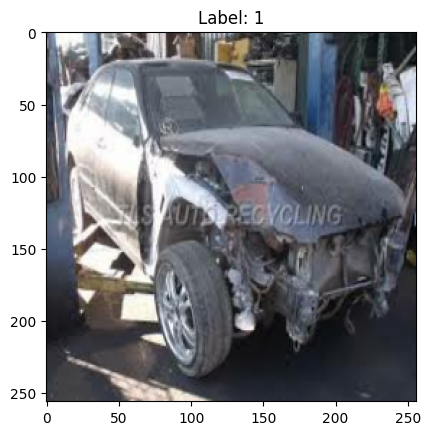

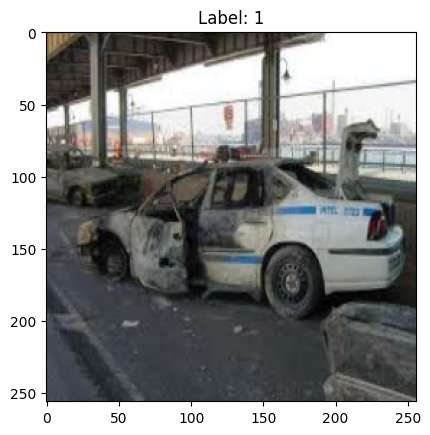

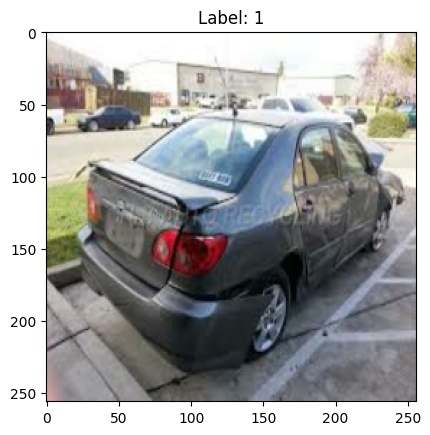

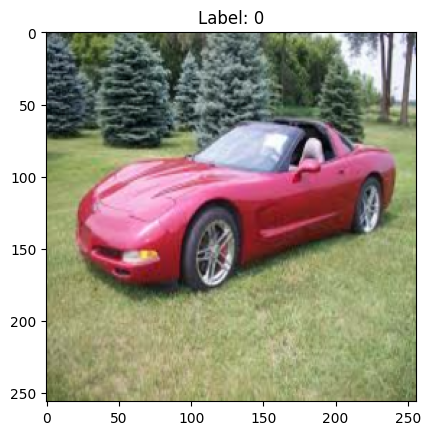

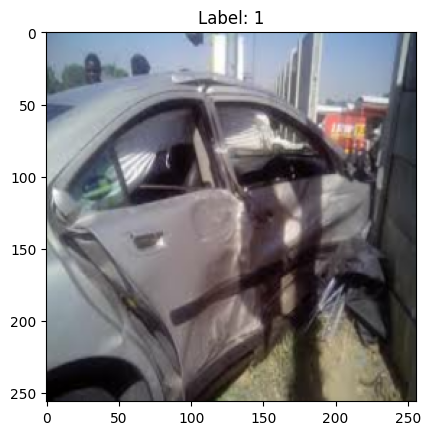

...

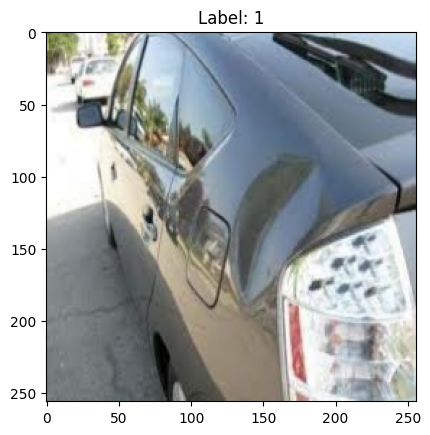

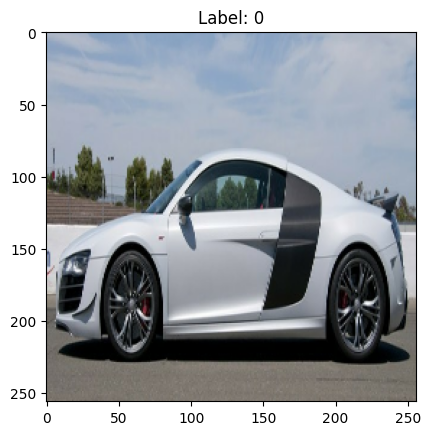

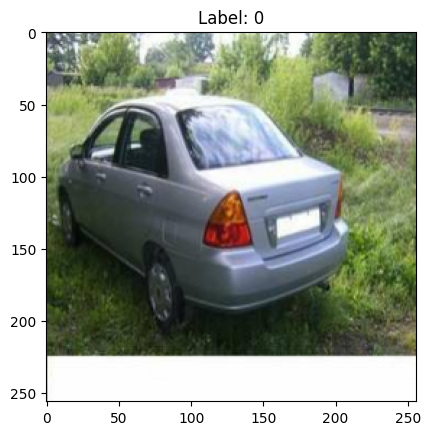

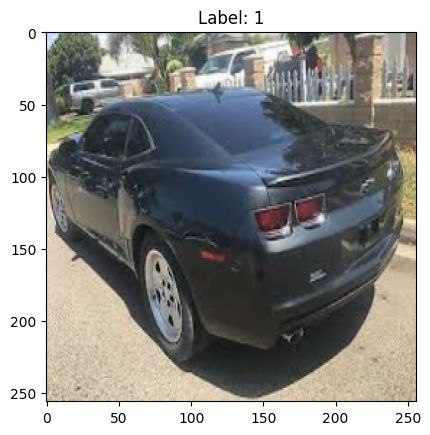

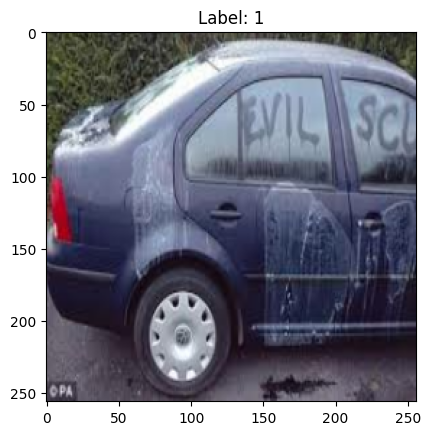

In [6]:
# for element in data:
#     images, labels = element
#     for i in range(len(images)):
#         # Assuming you are using matplotlib to display images
#         plt.imshow(images[i].numpy().astype("uint8"))
#         plt.title(f"Label: {labels[i].numpy()}")
#         plt.show()

# Counter to keep track of the number of images printed
# Define a dictionary to keep track of the number of images shown for each class
num_images_shown_per_class = {}

# Iterate through the dataset and print only the first 10 images from each class
for images, labels in data:
    for i in range(len(images)):
        label = labels[i].numpy()
        
        # Check if the current label exists in the dictionary
        if label not in num_images_shown_per_class:
            num_images_shown_per_class[label] = 0
        
        # Display the image using matplotlib if fewer than 10 images have been shown for this class
        if num_images_shown_per_class[label] < 10:
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(f"Label: {label}")
            plt.show()
            
            # Increment the counter for the current class
            num_images_shown_per_class[label] += 1
            
        # Check if 10 images have been shown for each class
        if all(count >= 10 for count in num_images_shown_per_class.values()):
            break
            
    # Check if 10 images have been shown for each class
    if all(count >= 10 for count in num_images_shown_per_class.values()):
        break



In [7]:
   #  print(f"Type of element: {type(element)}")
print(f"Type of images: {type(images)}")
print(f"Type of labels: {type(labels)}")

Type of images: <class 'tensorflow.python.framework.ops.EagerTensor'>
Type of labels: <class 'tensorflow.python.framework.ops.EagerTensor'>


In [8]:
# Check the size of the images
image_size = data.element_spec[0].shape[1:3]
print("Image size:", image_size)

Image size: (256, 256)


In [9]:
data_iterator=data.as_numpy_iterator()
batch=data_iterator.next()
#image representative as numpy array
print(len(batch))
batch[0].shape
batch[1]

2


array([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1,
       1, 0, 0, 0, 0, 1, 0, 0, 0, 0])

In [10]:
batch_size = batch[0].shape[0]
print("Batch size:", batch_size)

Batch size: 32


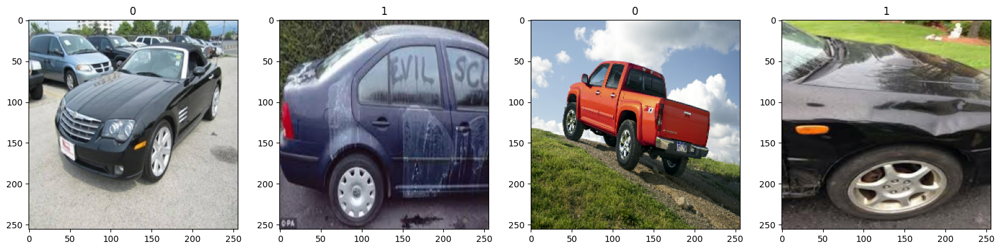

In [11]:
fig,ax=plt.subplots(ncols=4,figsize=(20,20))
for idx,img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

Pre_Process Data

In [12]:
data=data.map(lambda x,y: (x/255 ,y))

In [13]:
data.as_numpy_iterator().next()


(array([[[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          ...,
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],
 
         [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          ...,
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],
 
         [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          ...,
          [0.00000000e+00, 0.00000000e+00, 0.0000

In [14]:
len(data) #represent batch size

41

In [15]:
train_size=int(len(data)*.7)-1
val_size=int(len(data)*.2)+1
test_size=int(len(data)*.1)+1

In [16]:
print(train_size,val_size,test_size)

27 9 5


In [17]:
train=data.take(train_size)
val=data.skip(train_size).take(val_size)
test=data.skip(train_size+val_size).take(test_size)

In [18]:
# #Assuming 4 classes (adjust as needed)
# num_classes = 5

# # Image size
# img_height, img_width = 256, 256

# model = models.Sequential([
#     layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
#     layers.MaxPooling2D((2, 2)),
#     layers.Conv2D(64, (3, 3), activation='relu'),
#     layers.MaxPooling2D((2, 2)),
#     layers.Conv2D(128, (3, 3), activation='relu'),
#     layers.MaxPooling2D((2, 2)),
#     layers.Flatten(),
#     layers.Dense(256, activation='relu'),
#     layers.Dense(num_classes, activation='softmax')  # Multi-class classification, so using softmax activation
# ])
#Assuming 4 classes (adjust as needed)
num_classes = 2

# Image size
img_height, img_width = 256, 256

model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(256, activation='relu'),
    layers.Dense(num_classes, activation='softmax')  # Multi-class classification, so using sigmoid activation
])

c:\Users\PC\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


In [19]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 115200)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │    29,491,456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           514 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 29,585,218 (112.86 MB)

 Trainable params: 29,585,218 (112.86 MB)

 Non-trainable params: 0 (0.00 B)

In [20]:
# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# model.compile(optimizer='adam',
#               loss='binary_crossentropy',  # Use binary crossentropy for binary classification
#               metrics=['accuracy'])


TRAin model


In [21]:
logsdir='.\logs'

<>:1: SyntaxWarning: invalid escape sequence '\l'
<>:1: SyntaxWarning: invalid escape sequence '\l'
C:\Users\PC\AppData\Local\Temp\ipykernel_18900\2887880687.py:1: SyntaxWarning: invalid escape sequence '\l'
  logsdir='.\logs'


In [22]:
tensorboard_callback=tf.keras.callbacks.TensorBoard(log_dir=logsdir)

In [24]:
hist=model.fit(train,epochs=7,validation_data=val,callbacks=[tensorboard_callback])

Epoch 1/7


27/27 ━━━━━━━━━━━━━━━━━━━━ 31s 1s/step - accuracy: 0.5326 - loss: 4.6078 - val_accuracy: 0.5729 - val_loss: 0.6542
Epoch 2/7
27/27 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.6362 - loss: 0.6260 - val_accuracy: 0.7639 - val_loss: 0.5603
Epoch 3/7
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.7316 - loss: 0.5234 - val_accuracy: 0.7986 - val_loss: 0.4658
Epoch 4/7
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.8200 - loss: 0.3759 - val_accuracy: 0.8090 - val_loss: 0.4549
Epoch 5/7
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.8799 - loss: 0.3299 - val_accuracy: 0.7847 - val_loss: 0.4476
Epoch 6/7
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.9103 - loss: 0.2483 - val_accuracy: 0.8229 - val_loss: 0.3814
Epoch 7/7
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.9428 - loss: 0.1851 - val_accuracy: 0.8021 - val_loss: 0.4917


In [25]:
hist.history

{'accuracy': [0.5370370149612427,
  0.6539351940155029,
  0.7546296119689941,
  0.8078703880310059,
  0.8518518805503845,
  0.9016203880310059,
  0.9375],
 'loss': [1.8310675621032715,
  0.6124476790428162,
  0.5152938365936279,
  0.40445616841316223,
  0.3635757863521576,
  0.24460284411907196,
  0.18595339357852936],
 'val_accuracy': [0.5729166865348816,
  0.7638888955116272,
  0.7986111044883728,
  0.8090277910232544,
  0.7847222089767456,
  0.8229166865348816,
  0.8020833134651184],
 'val_loss': [0.6541788578033447,
  0.5603379011154175,
  0.46576377749443054,
  0.4549287259578705,
  0.44763946533203125,
  0.3813926577568054,
  0.4917229115962982]}

PLOT Performance

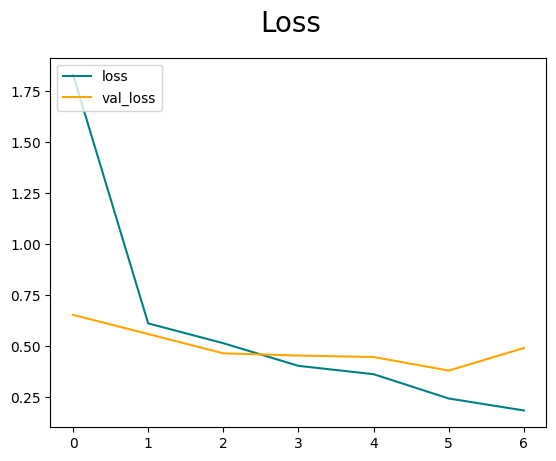

In [26]:
fig=plt.figure()
plt.plot(hist.history['loss'],color='teal',label='loss')
plt.plot(hist.history['val_loss'],color='orange',label='val_loss')
fig.suptitle('Loss',fontsize=20)
plt.legend(loc="upper left")
plt.show()

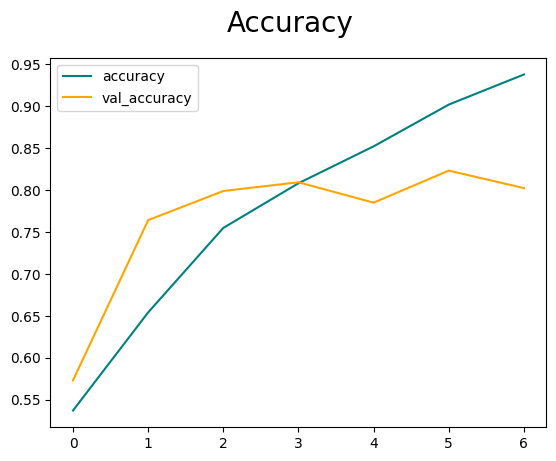

In [27]:
fig=plt.figure()
plt.plot(hist.history['accuracy'],color='teal',label='accuracy')
plt.plot(hist.history['val_accuracy'],color='orange',label='val_accuracy')
fig.suptitle('Accuracy',fontsize=20)
plt.legend(loc="upper left")
plt.show()

Evaluate Performance


In [28]:
#For confusion matrix
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns

true_labels = []
predicted_labels = []

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    yhat_classes = np.argmax(yhat, axis=1)
    true_labels.extend(y)
    predicted_labels.extend(yhat_classes)

true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Confusion Matrix:
[[58 30]
 [ 4 46]]


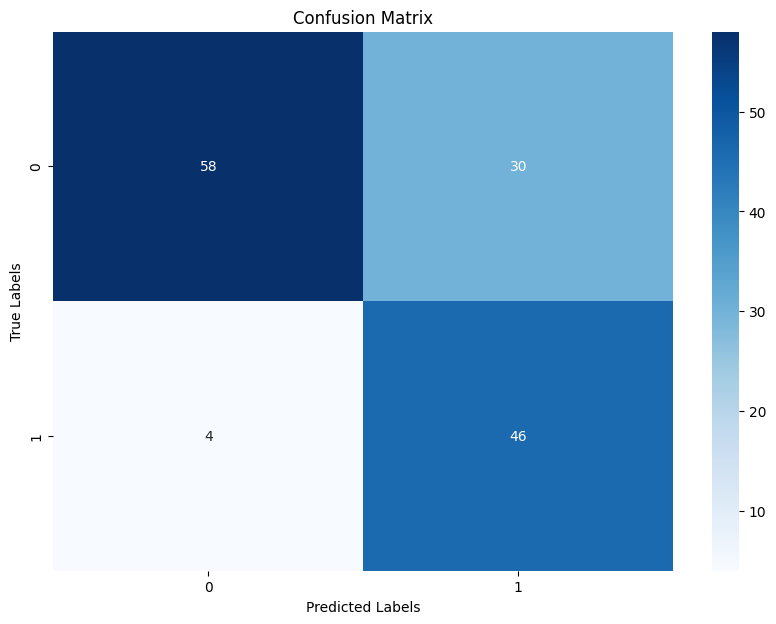

In [29]:
# Compute the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Print the confusion matrix
print("Confusion Matrix:")
print(cm)

# Plot the confusion matrix using Seaborn for better visualization
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=True, yticklabels=True)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [30]:
from tensorflow.keras.metrics import Precision,Recall,SparseCategoricalAccuracy,CategoricalAccuracy

In [31]:
pre=Precision()
re=Recall()
acc=CategoricalAccuracy()

In [32]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    print(y.shape)
    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)
    
    for actual, predicted in zip(y, yhat_classes):
        print(f"Actual: {actual}, Predicted: {predicted}")
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
(32,)
Actual: 0, Predicted: 0
Actual: 0, Predicted: 1
Actual: 0, Predicted: 1
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 1
Actual: 0, Predicted: 1
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 0
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 1
Actual: 1, Predicted: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
(32,)
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 1
Actual: 1, Predicted: 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
Actual: 1, Predicted: 1


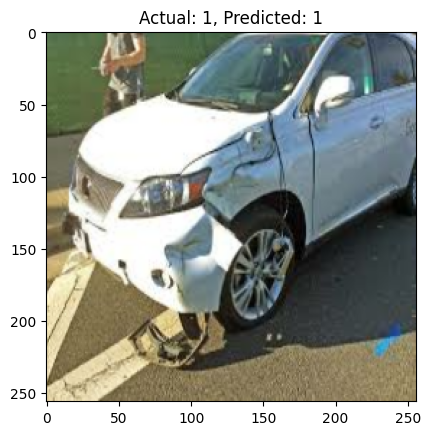

Actual: 1, Predicted: 0


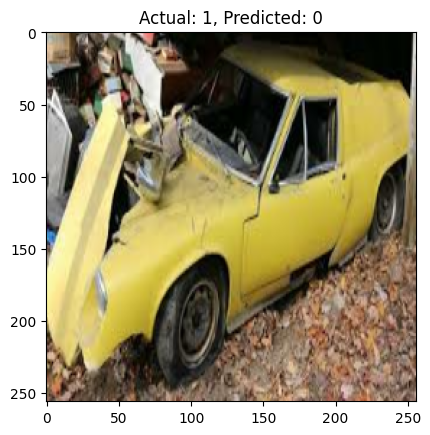

Actual: 1, Predicted: 0


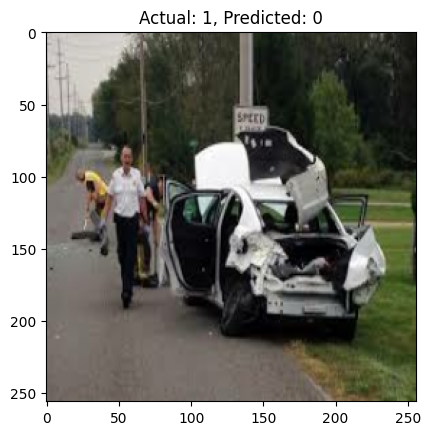

Actual: 1, Predicted: 1


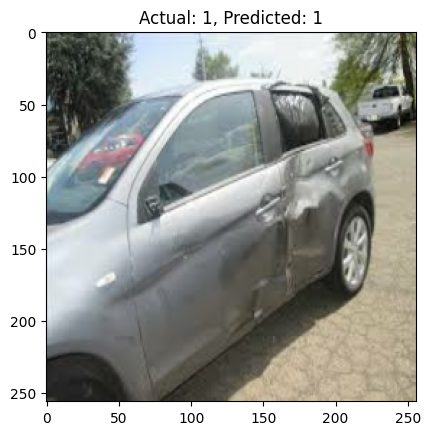

Actual: 1, Predicted: 1


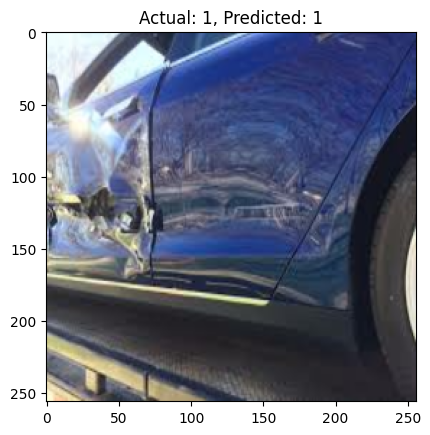

Actual: 0, Predicted: 0


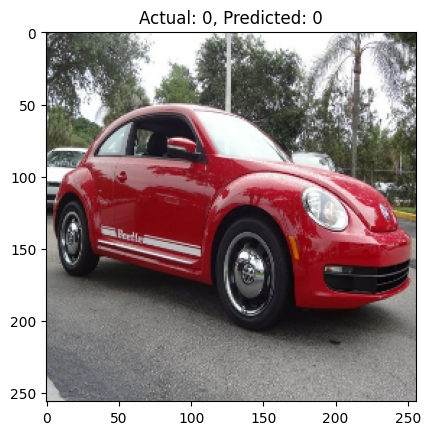

Actual: 0, Predicted: 0


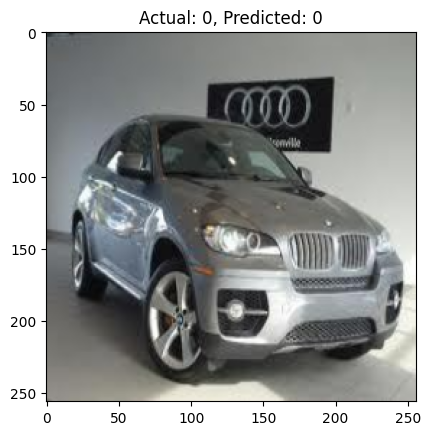

Actual: 0, Predicted: 0


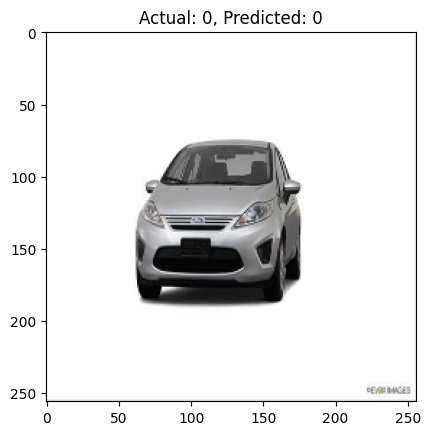

Actual: 0, Predicted: 1


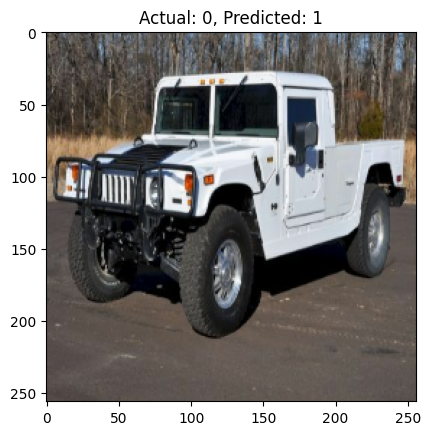

Actual: 0, Predicted: 0


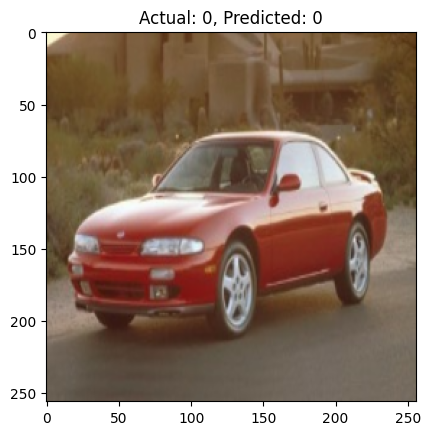

Actual: 0, Predicted: 0


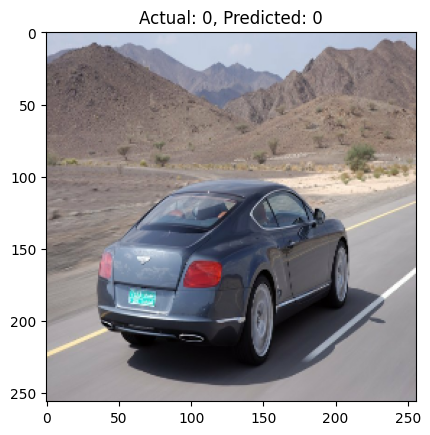

Actual: 0, Predicted: 1


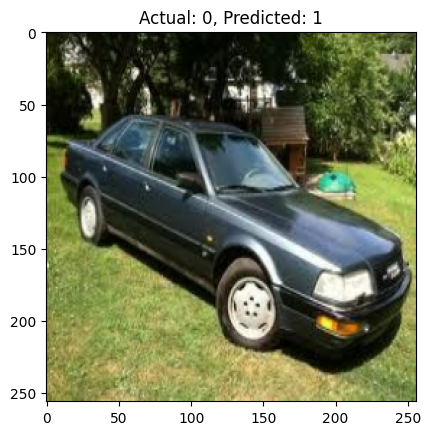

Actual: 1, Predicted: 0


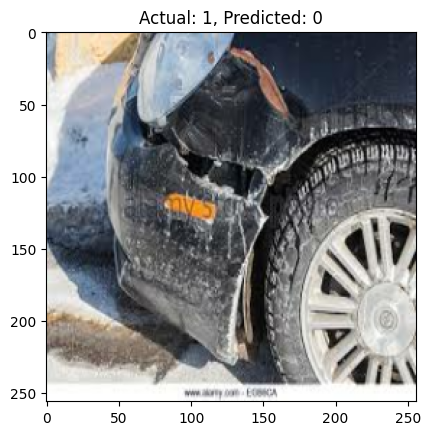

Actual: 1, Predicted: 1


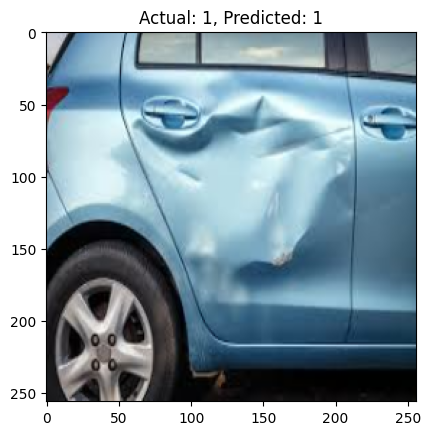

Actual: 0, Predicted: 1


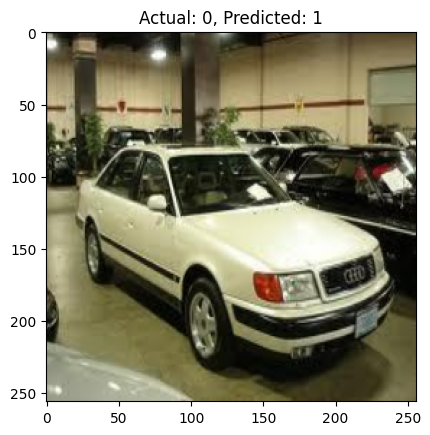

Actual: 1, Predicted: 1


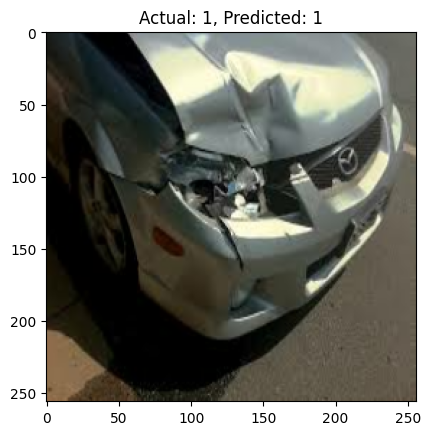

Actual: 1, Predicted: 1


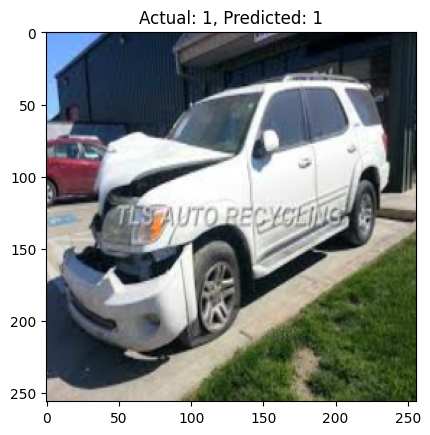

Actual: 0, Predicted: 0


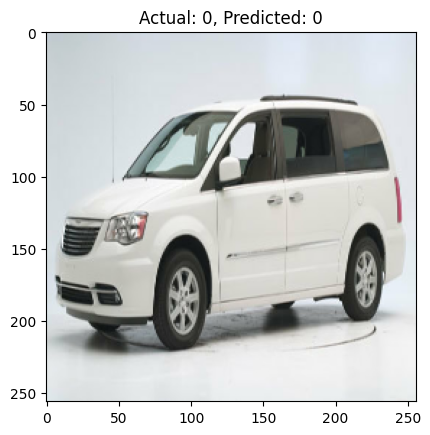

Actual: 0, Predicted: 1


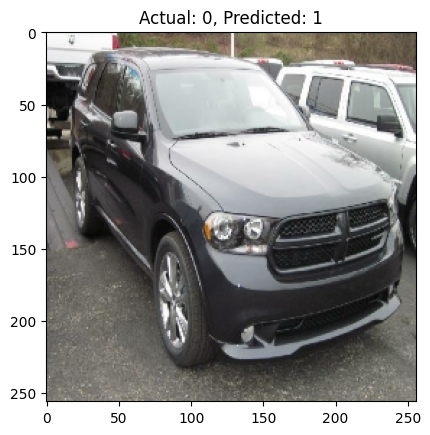

Actual: 0, Predicted: 0


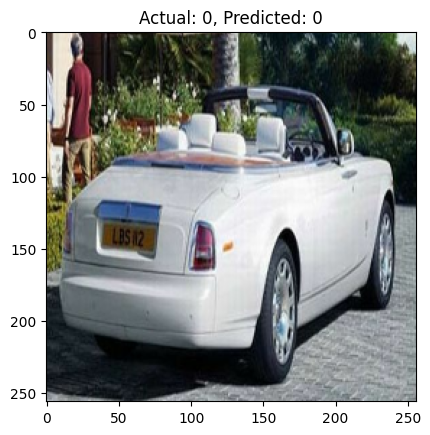

Actual: 0, Predicted: 0


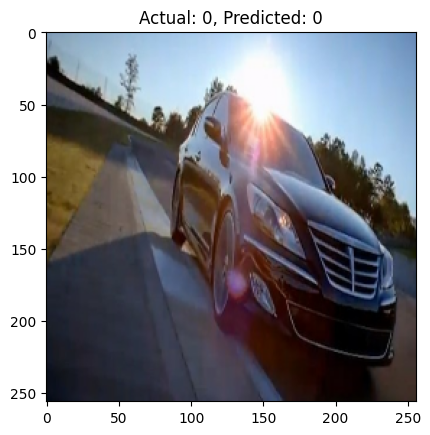

Actual: 1, Predicted: 1


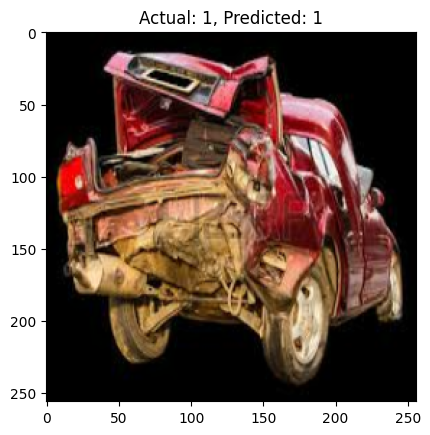

Actual: 0, Predicted: 0


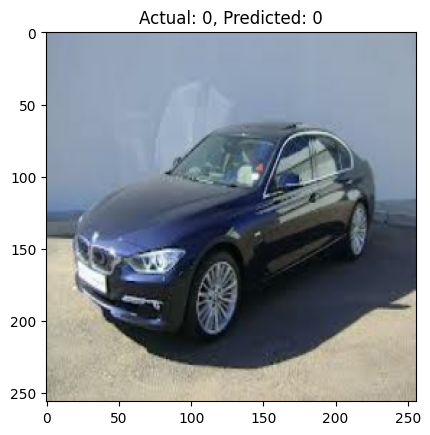

Actual: 0, Predicted: 0


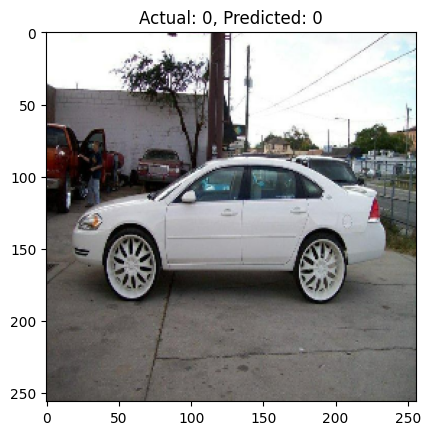

Actual: 1, Predicted: 1


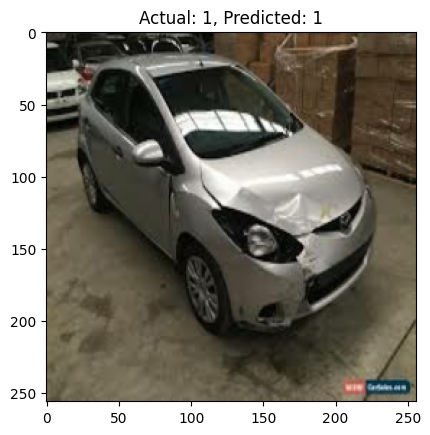

Actual: 0, Predicted: 0


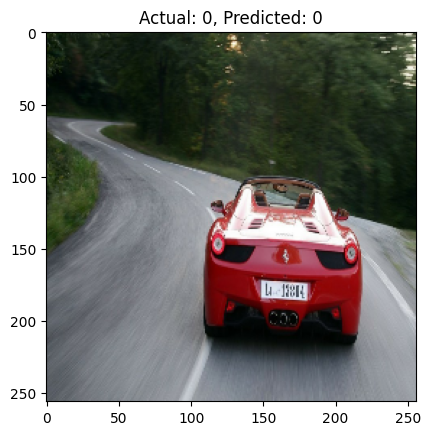

Actual: 1, Predicted: 1


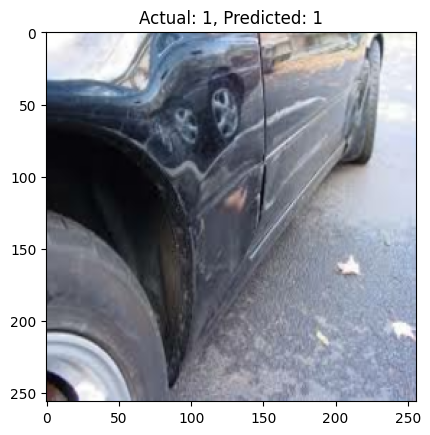

Actual: 0, Predicted: 0


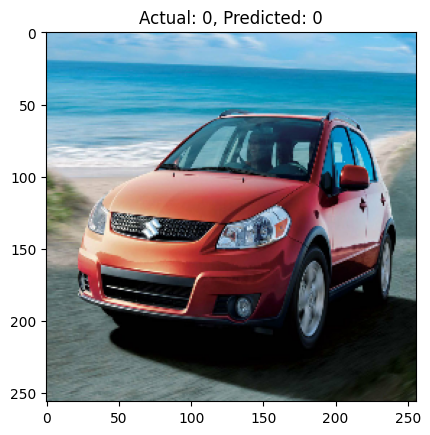

Actual: 0, Predicted: 0


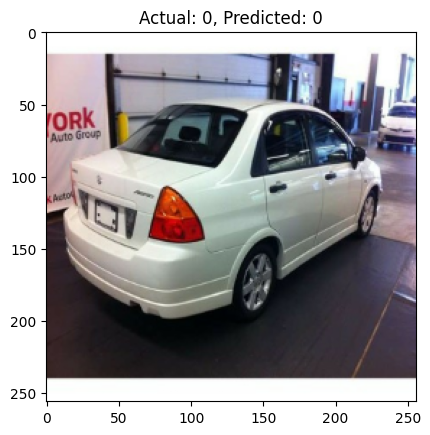

Actual: 1, Predicted: 1


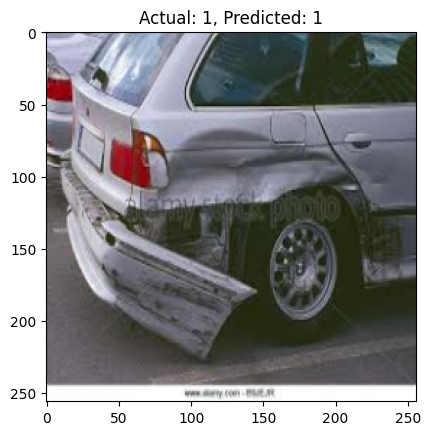

Actual: 0, Predicted: 0


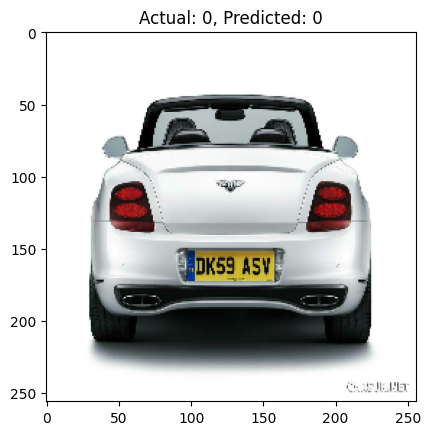

Actual: 1, Predicted: 1


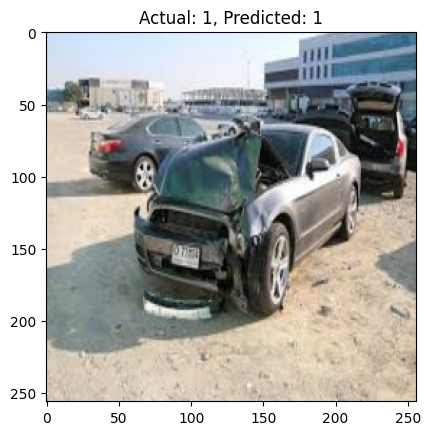

(32,) (32,)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
Actual: 1, Predicted: 1


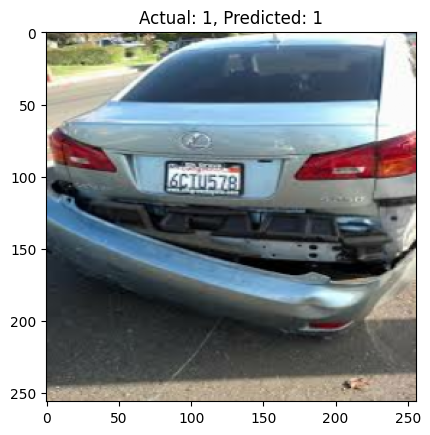

Actual: 0, Predicted: 0


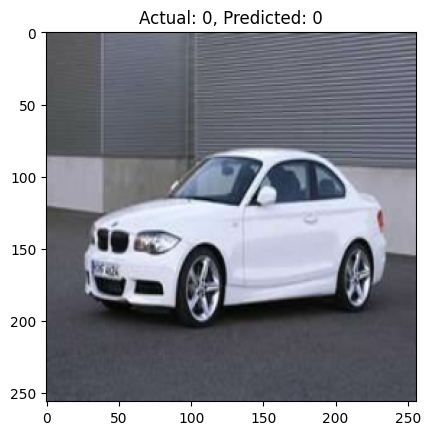

Actual: 0, Predicted: 0


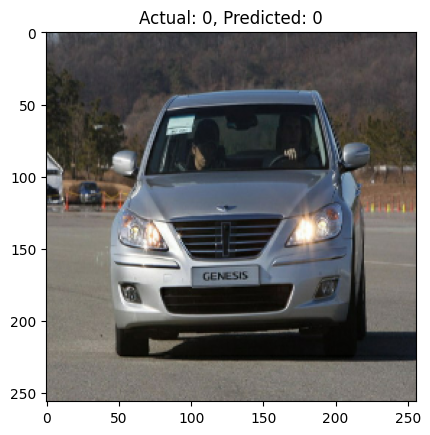

Actual: 1, Predicted: 1


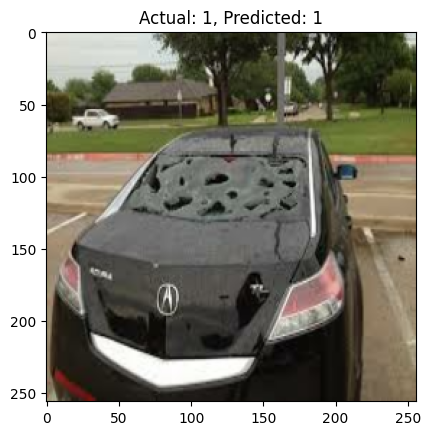

Actual: 0, Predicted: 0


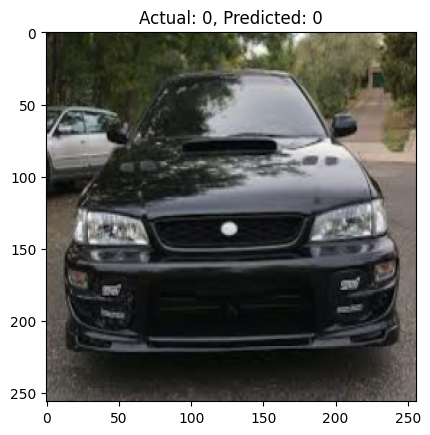

Actual: 0, Predicted: 1


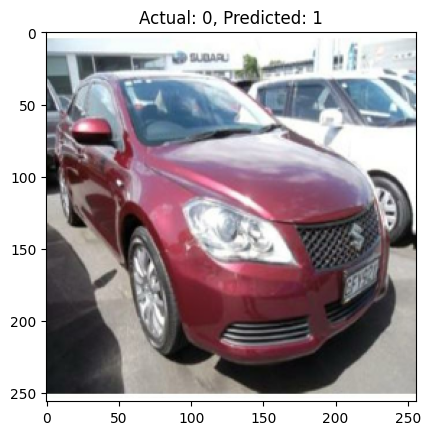

Actual: 0, Predicted: 0


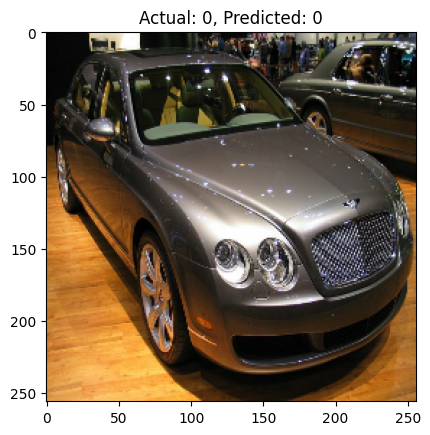

Actual: 1, Predicted: 1


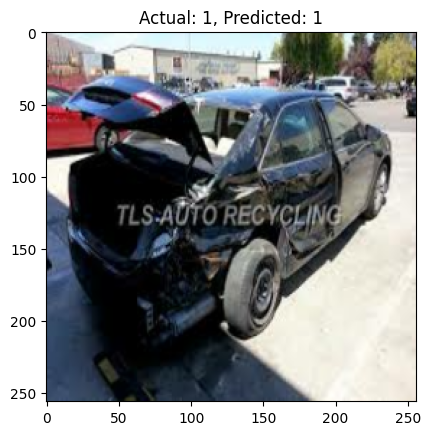

Actual: 0, Predicted: 0


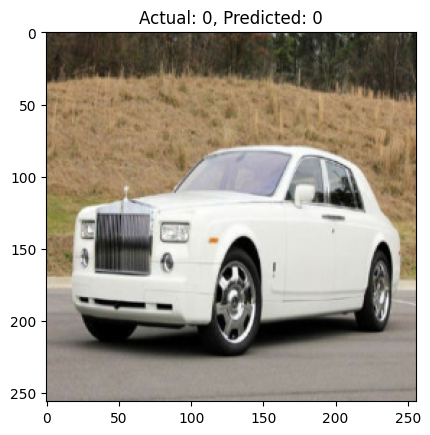

Actual: 1, Predicted: 1


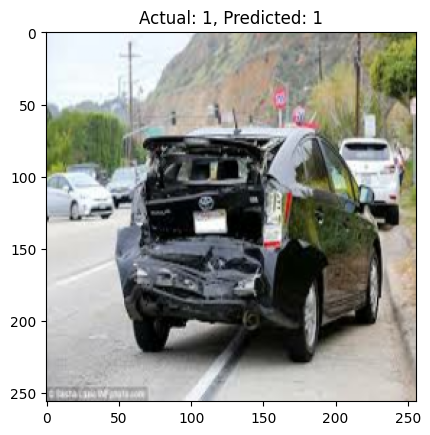

Actual: 1, Predicted: 1


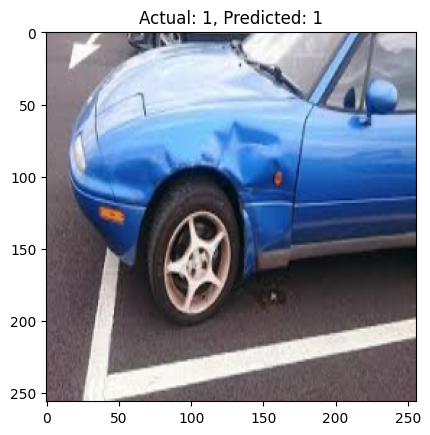

Actual: 1, Predicted: 1


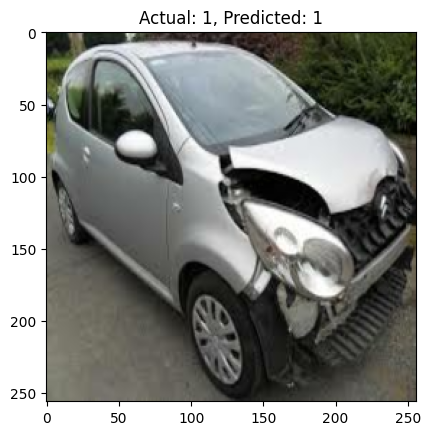

Actual: 1, Predicted: 1


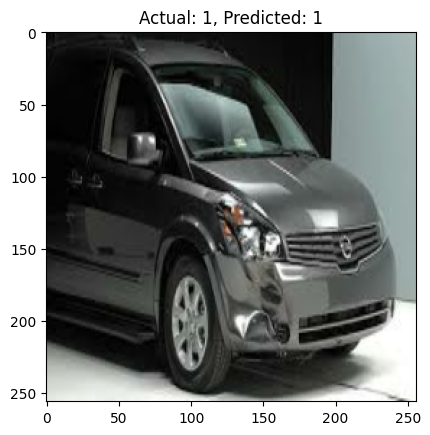

Actual: 1, Predicted: 1


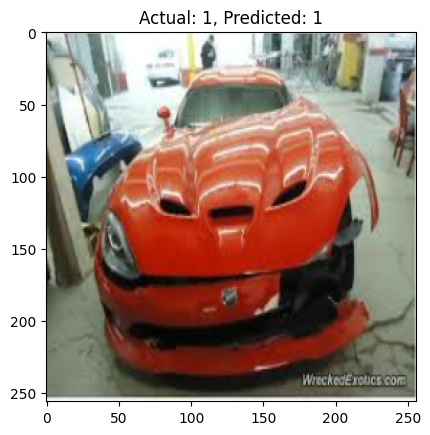

Actual: 0, Predicted: 0


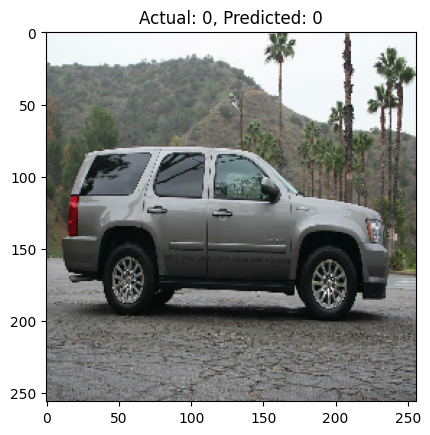

Actual: 0, Predicted: 0


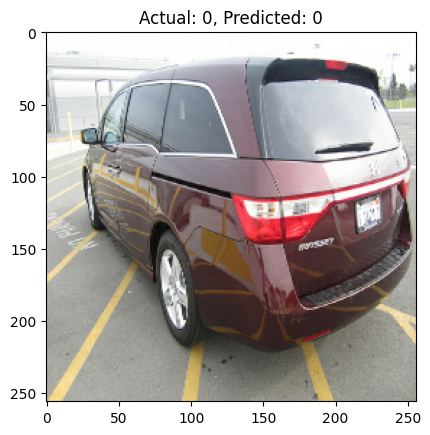

Actual: 1, Predicted: 1


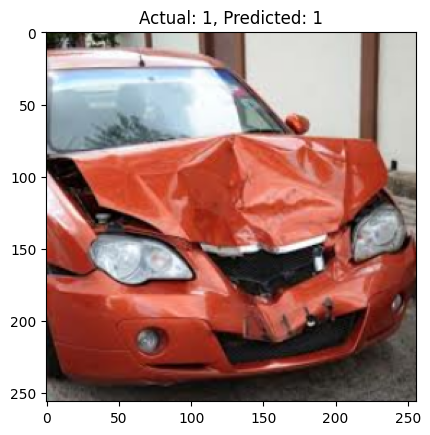

Actual: 1, Predicted: 1


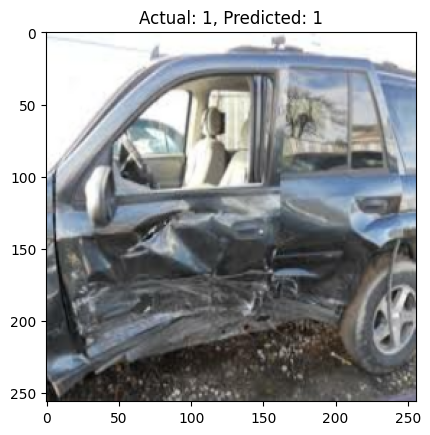

Actual: 0, Predicted: 1


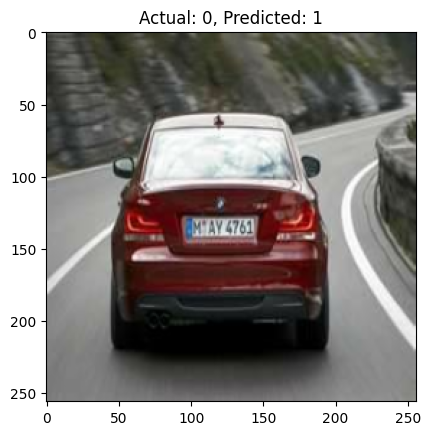

Actual: 0, Predicted: 0


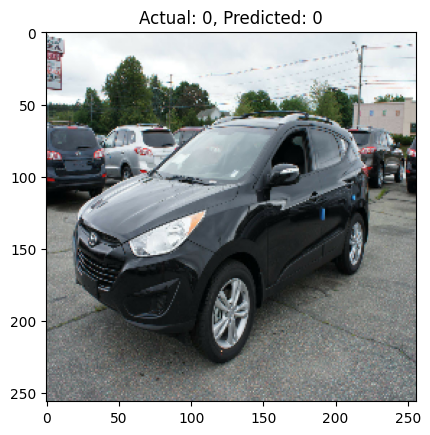

Actual: 1, Predicted: 1


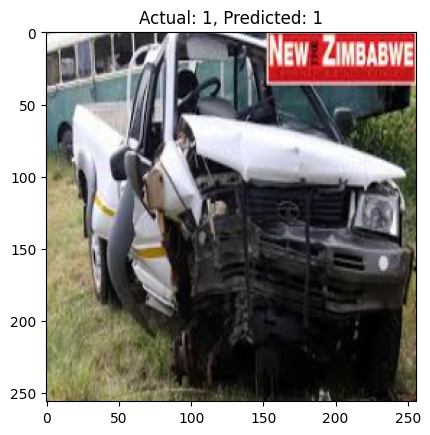

Actual: 0, Predicted: 1


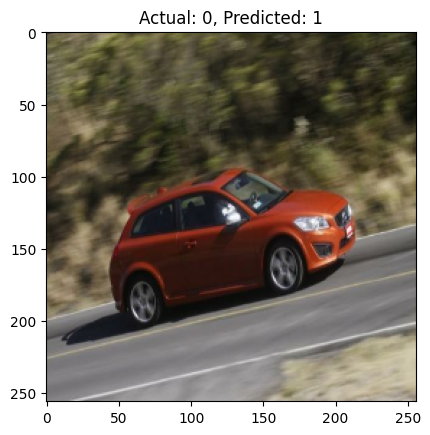

Actual: 0, Predicted: 0


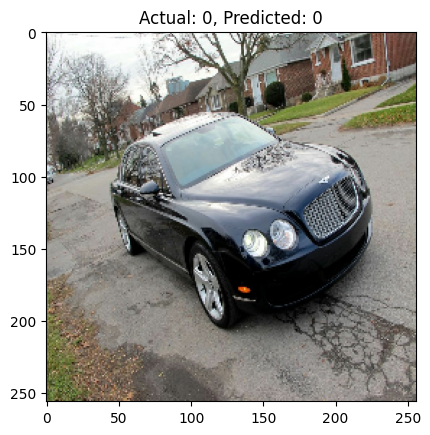

Actual: 0, Predicted: 0


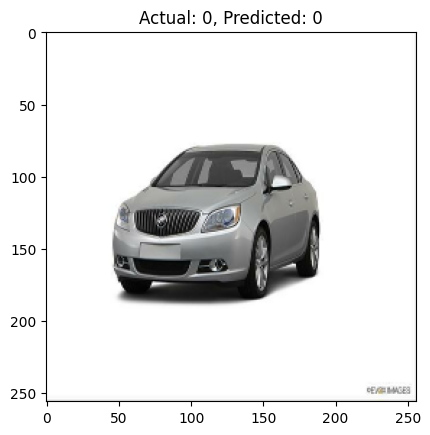

Actual: 1, Predicted: 1


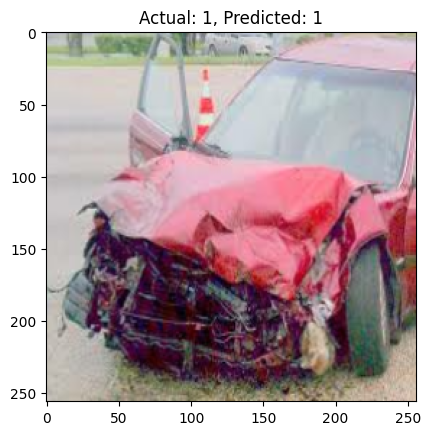

Actual: 1, Predicted: 1


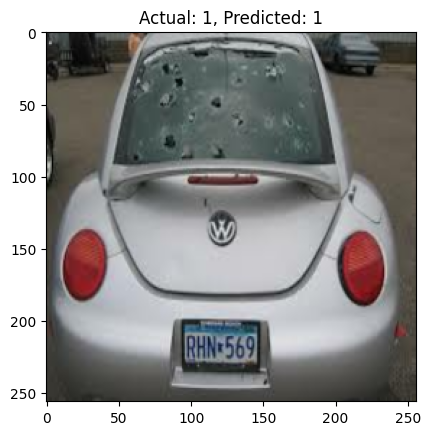

Actual: 1, Predicted: 0


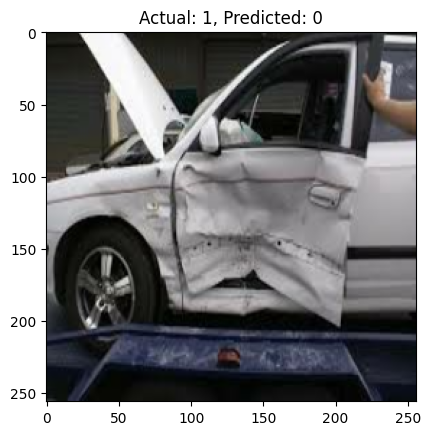

Actual: 0, Predicted: 0


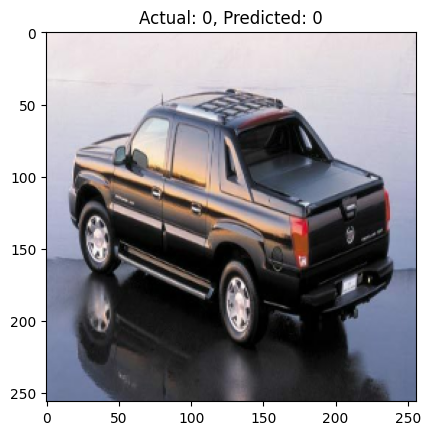

Actual: 0, Predicted: 0


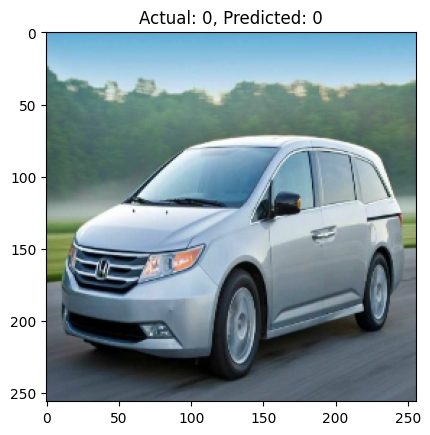

Actual: 0, Predicted: 1


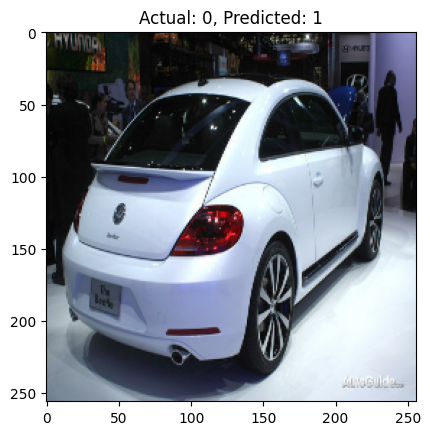

Actual: 1, Predicted: 1


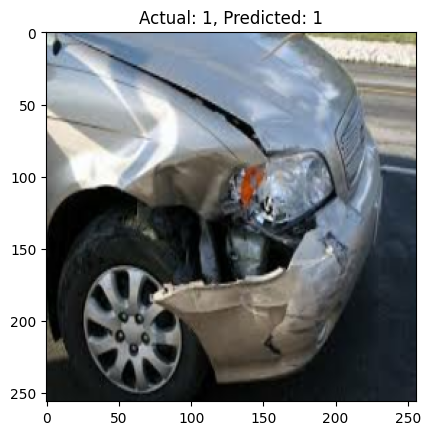

Actual: 0, Predicted: 0


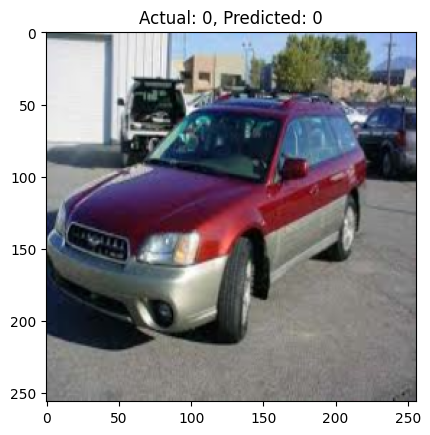

(32,) (32,)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
Actual: 1, Predicted: 1


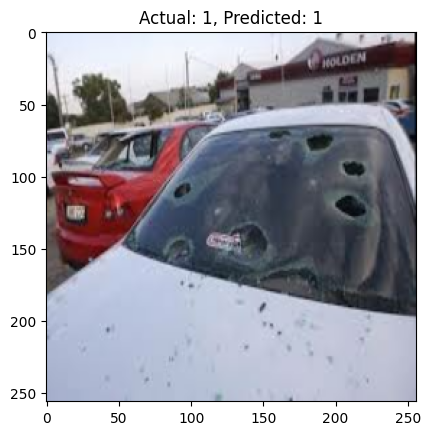

Actual: 1, Predicted: 1


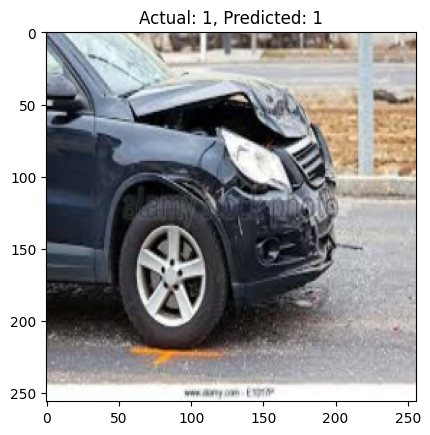

Actual: 1, Predicted: 1


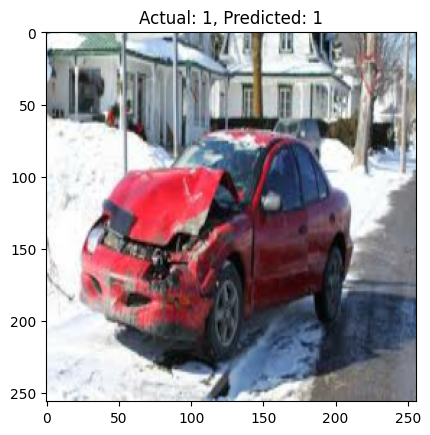

Actual: 0, Predicted: 1


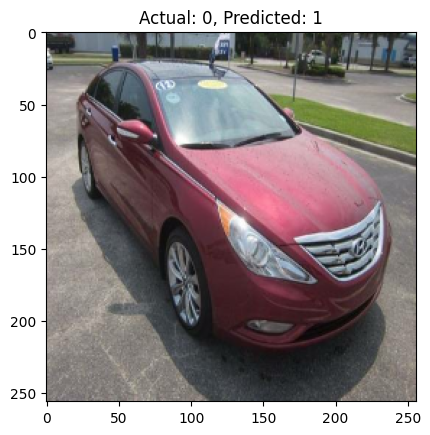

Actual: 1, Predicted: 1


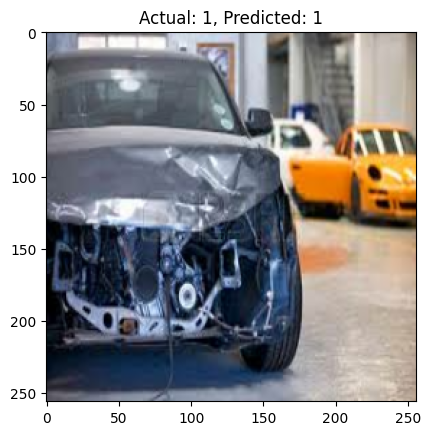

Actual: 1, Predicted: 1


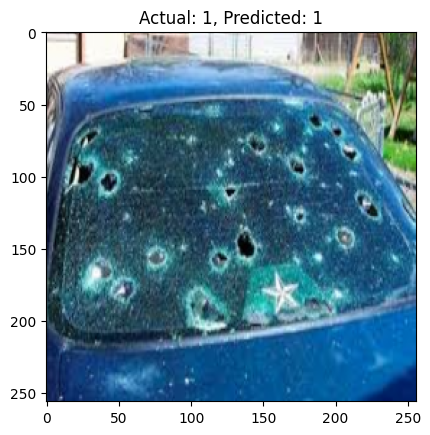

Actual: 1, Predicted: 1


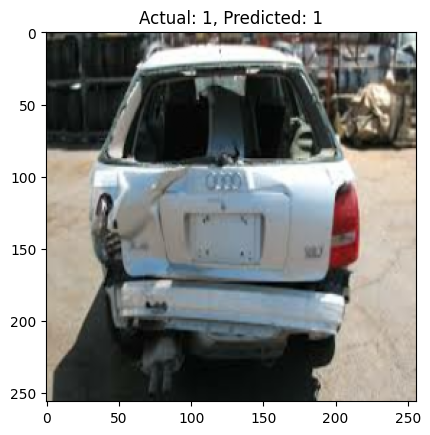

Actual: 1, Predicted: 1


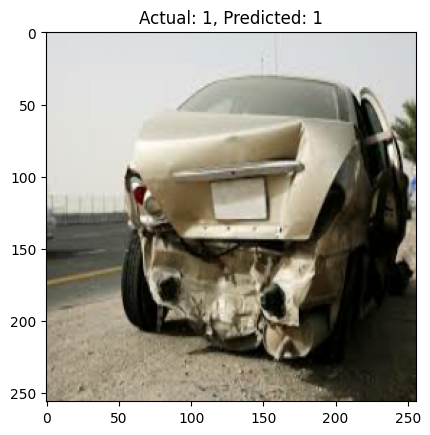

Actual: 0, Predicted: 1


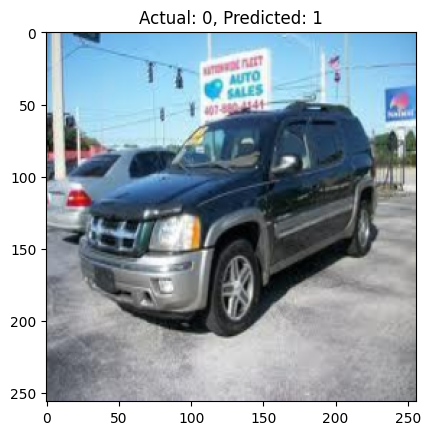

Actual: 0, Predicted: 0


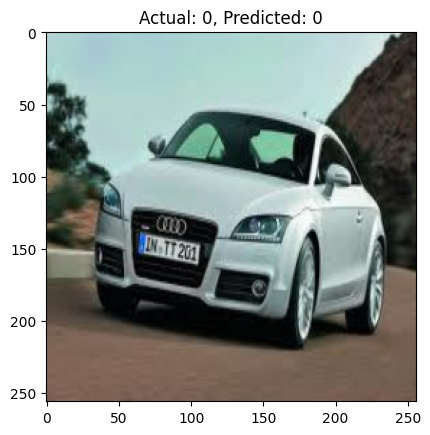

Actual: 0, Predicted: 0


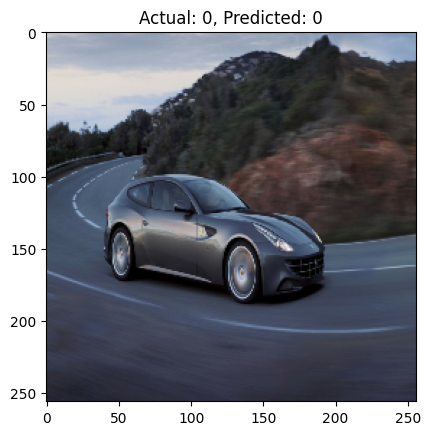

Actual: 0, Predicted: 1


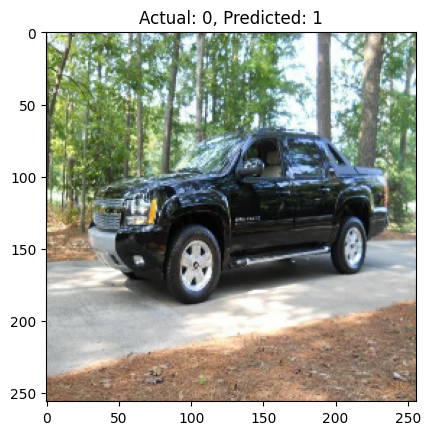

Actual: 1, Predicted: 1


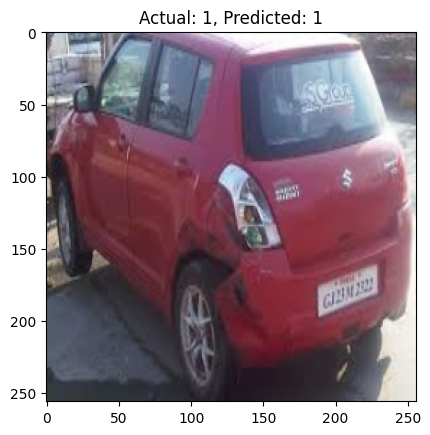

Actual: 0, Predicted: 0


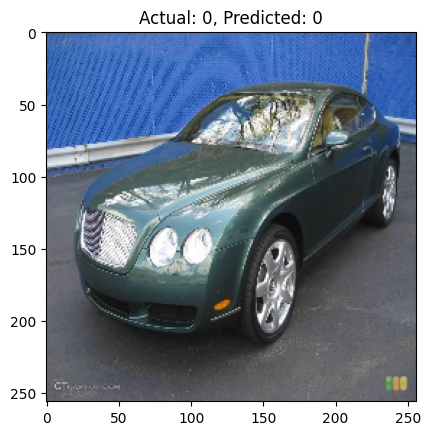

Actual: 1, Predicted: 1


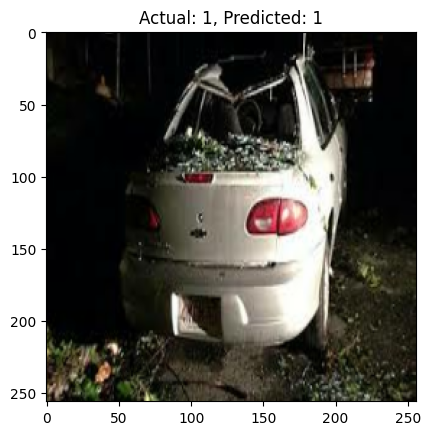

Actual: 0, Predicted: 0


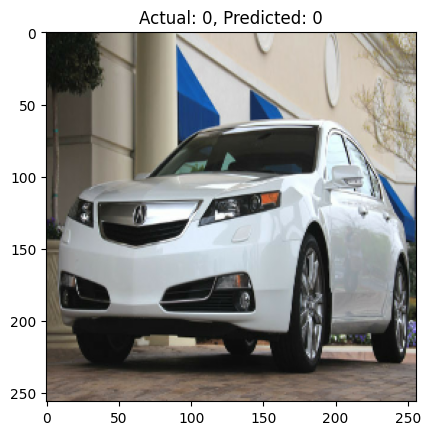

Actual: 1, Predicted: 1


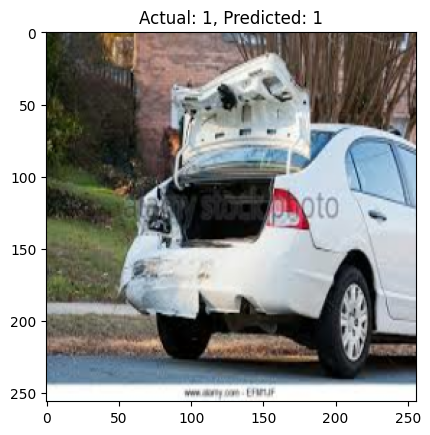

Actual: 1, Predicted: 1


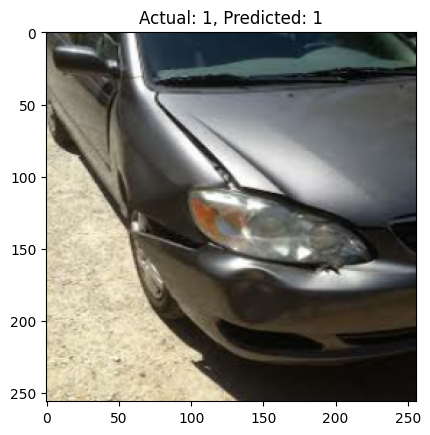

Actual: 1, Predicted: 1


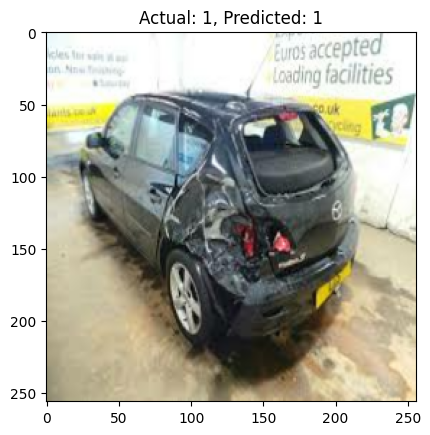

Actual: 1, Predicted: 1


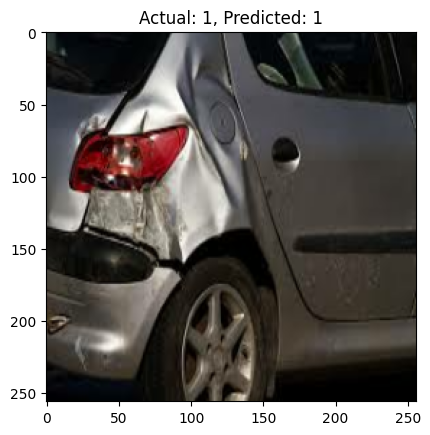

Actual: 0, Predicted: 0


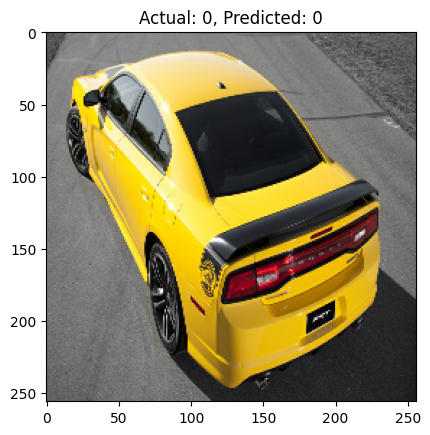

Actual: 1, Predicted: 1


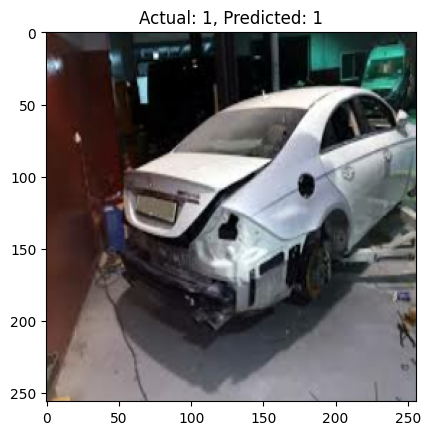

Actual: 0, Predicted: 1


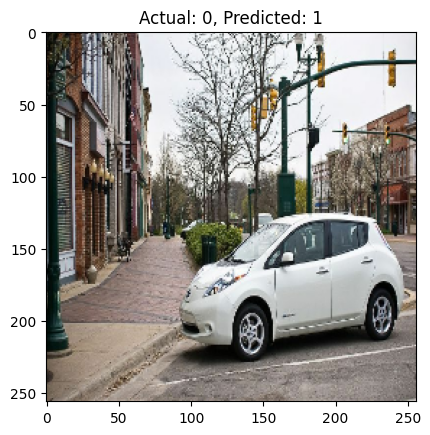

Actual: 1, Predicted: 1


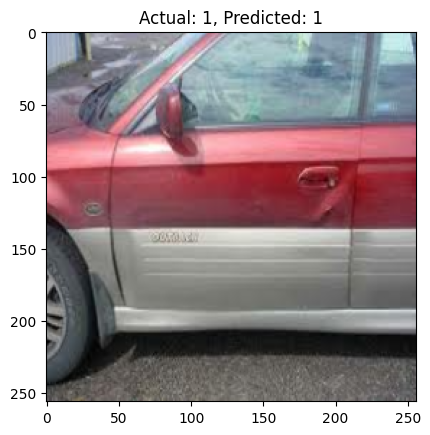

Actual: 1, Predicted: 1


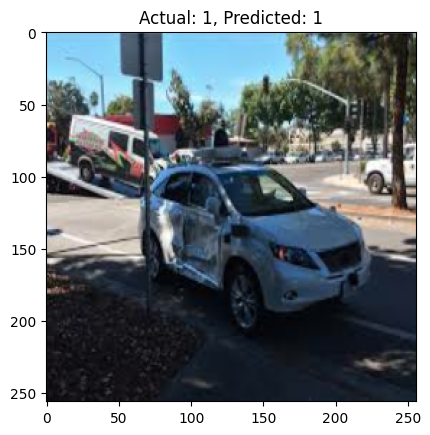

Actual: 0, Predicted: 1


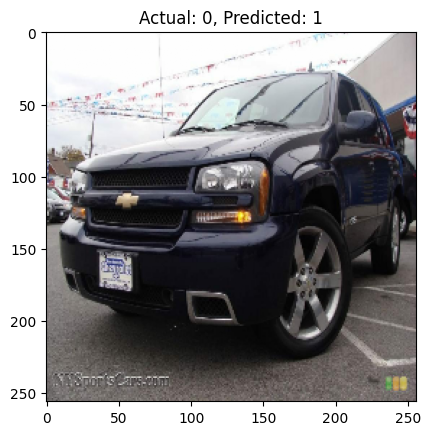

Actual: 1, Predicted: 1


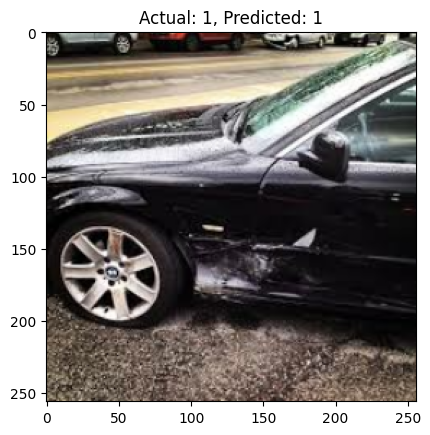

Actual: 1, Predicted: 1


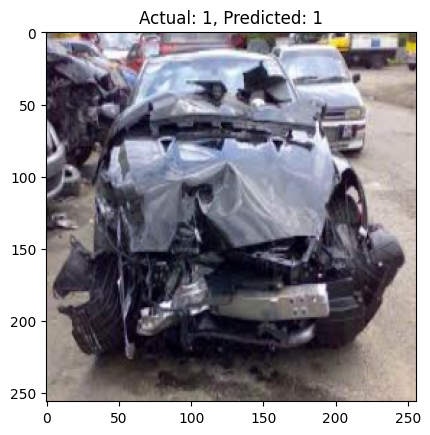

Actual: 1, Predicted: 1


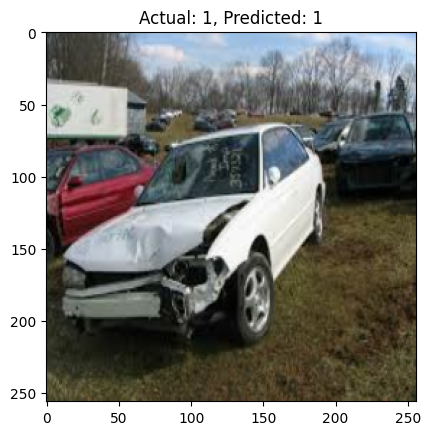

Actual: 1, Predicted: 1


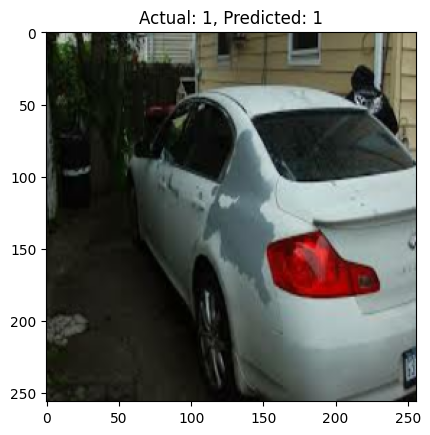

Actual: 0, Predicted: 1


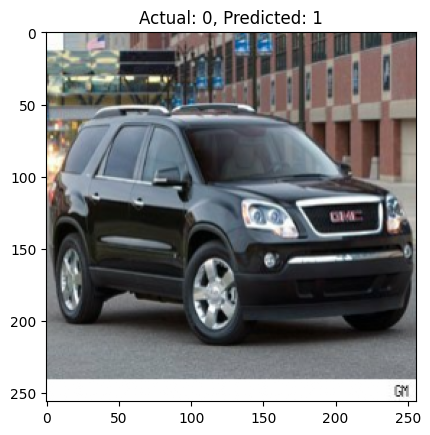

Actual: 0, Predicted: 0


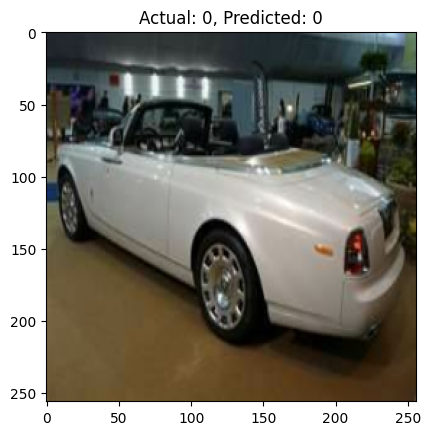

(32,) (32,)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
Actual: 0, Predicted: 1


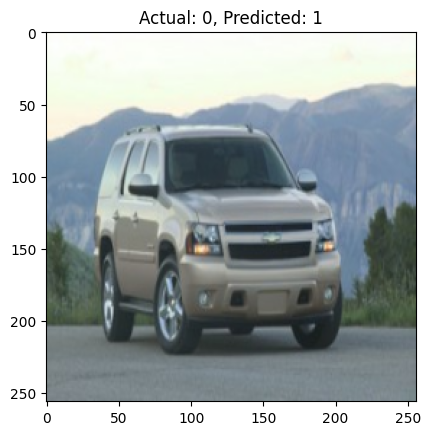

Actual: 1, Predicted: 0


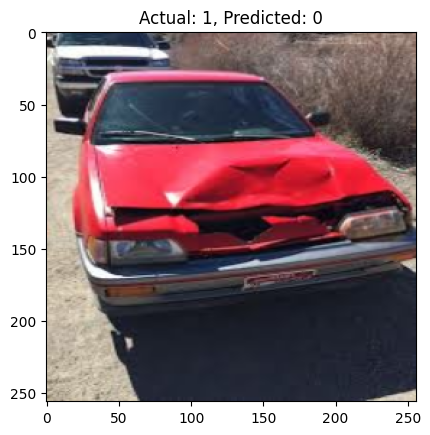

Actual: 1, Predicted: 1


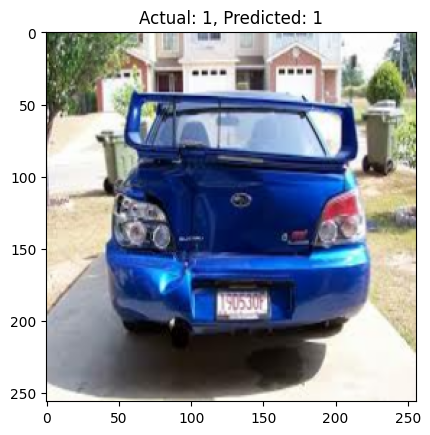

Actual: 0, Predicted: 1


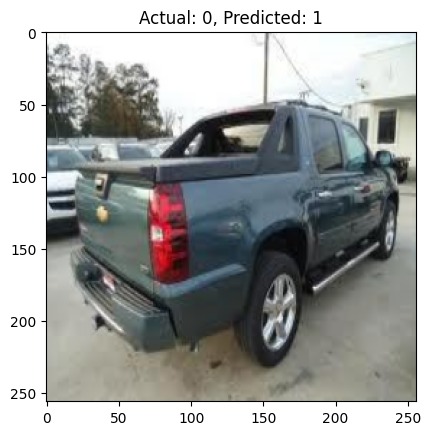

Actual: 0, Predicted: 0


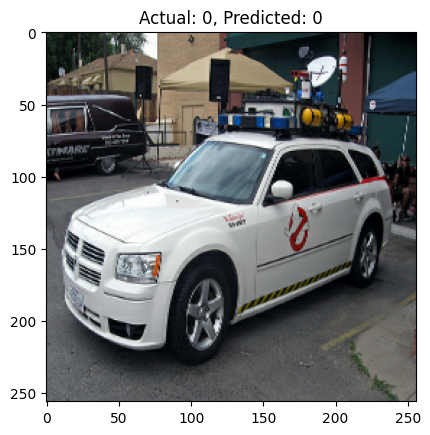

Actual: 1, Predicted: 1


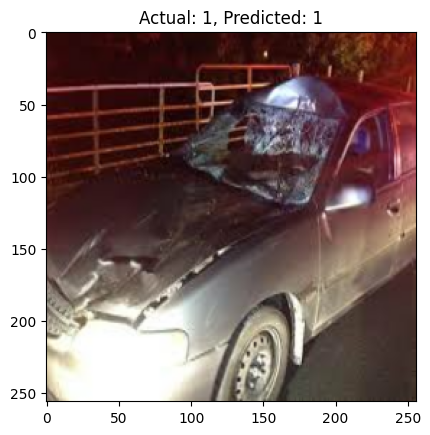

Actual: 0, Predicted: 0


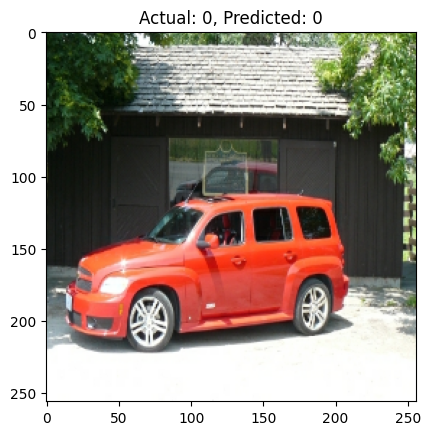

Actual: 1, Predicted: 1


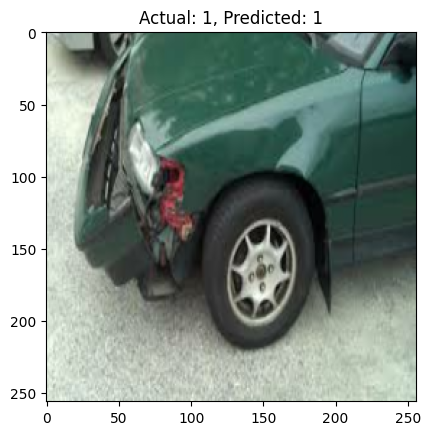

Actual: 0, Predicted: 0


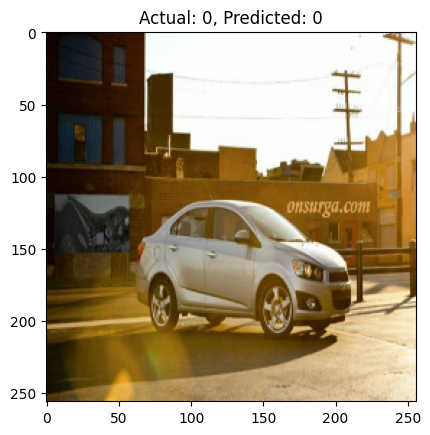

Actual: 1, Predicted: 1


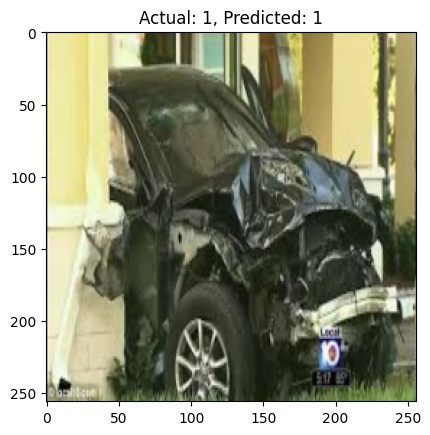

Actual: 0, Predicted: 0


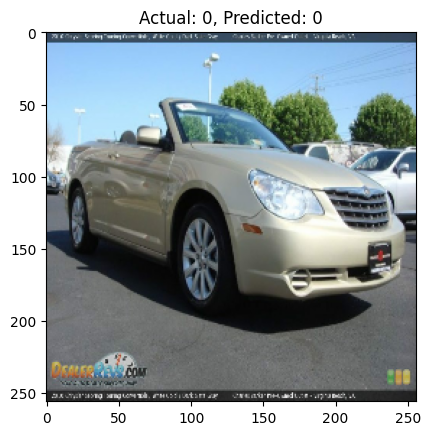

Actual: 0, Predicted: 0


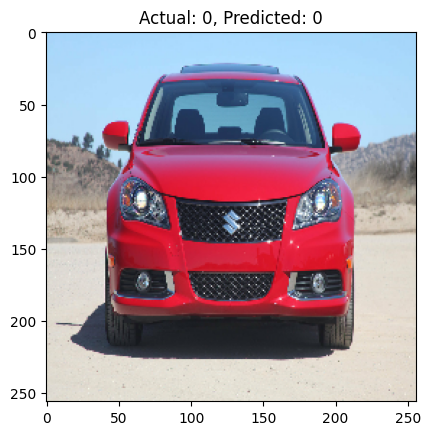

Actual: 1, Predicted: 1


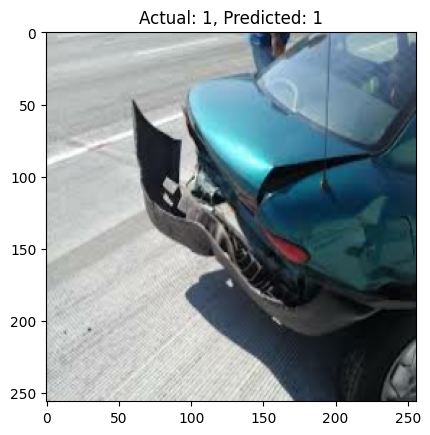

Actual: 0, Predicted: 0


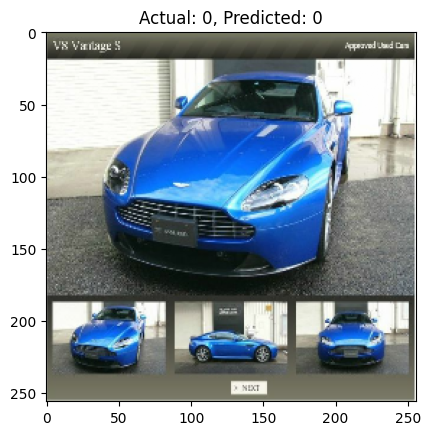

Actual: 0, Predicted: 0


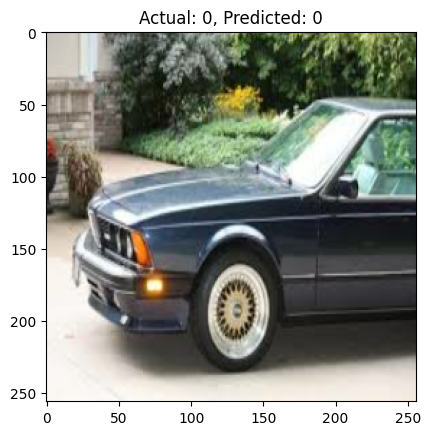

Actual: 1, Predicted: 1


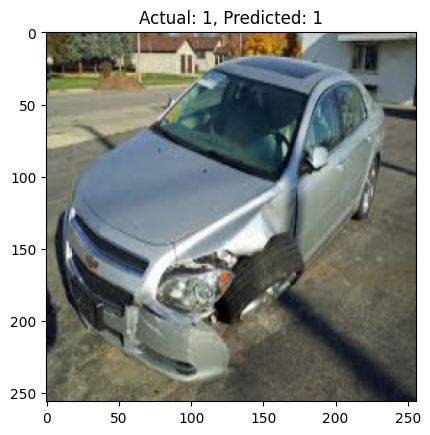

Actual: 1, Predicted: 1


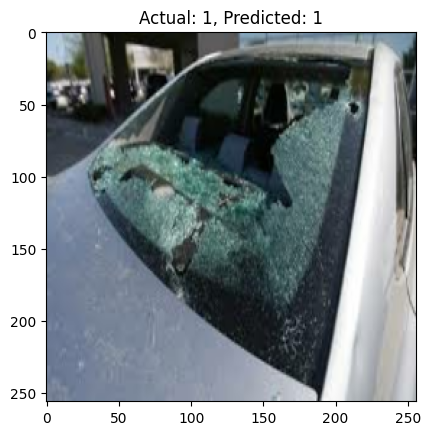

Actual: 0, Predicted: 1


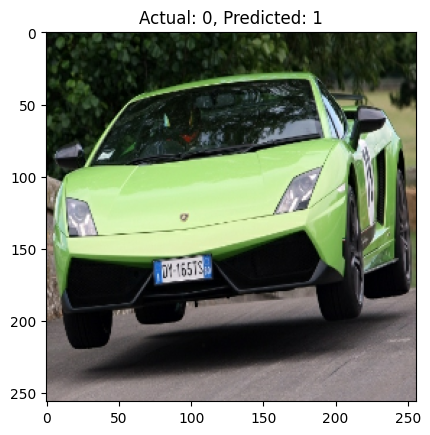

Actual: 0, Predicted: 0


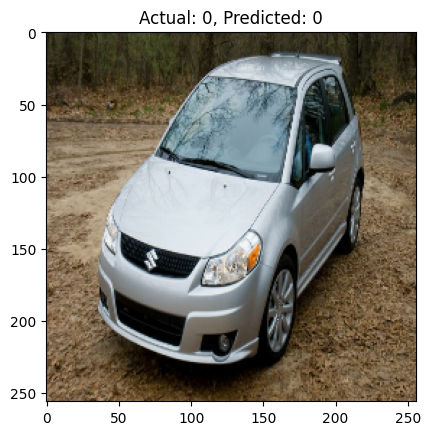

Actual: 0, Predicted: 0


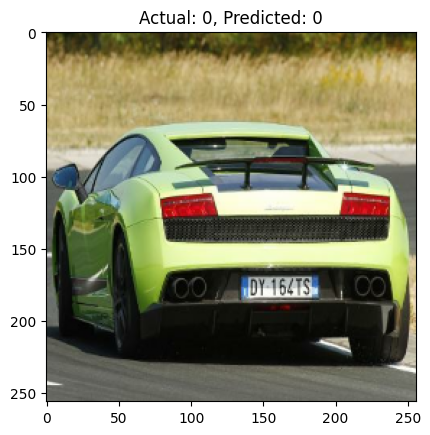

Actual: 1, Predicted: 1


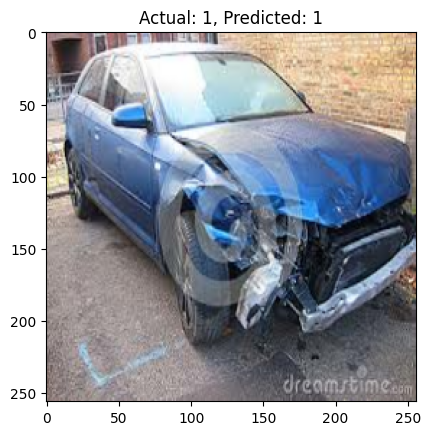

Actual: 0, Predicted: 1


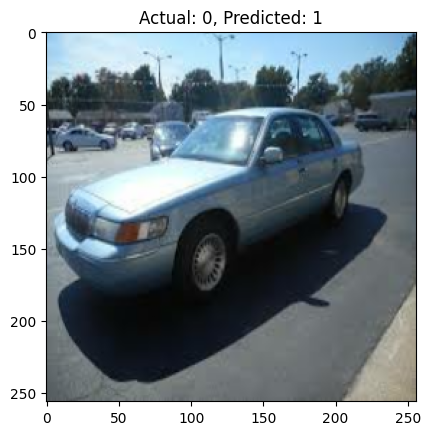

Actual: 1, Predicted: 1


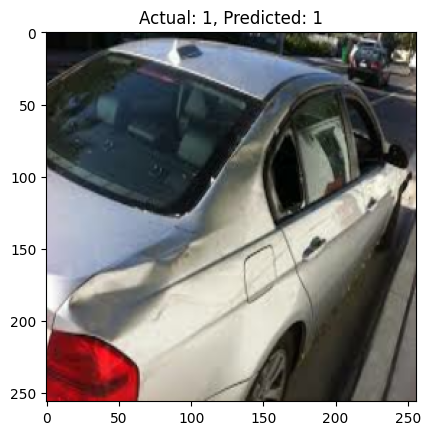

Actual: 1, Predicted: 1


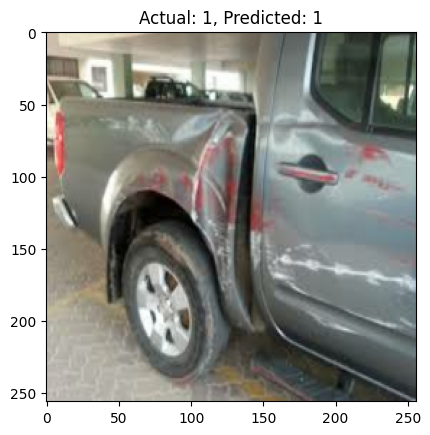

Actual: 0, Predicted: 0


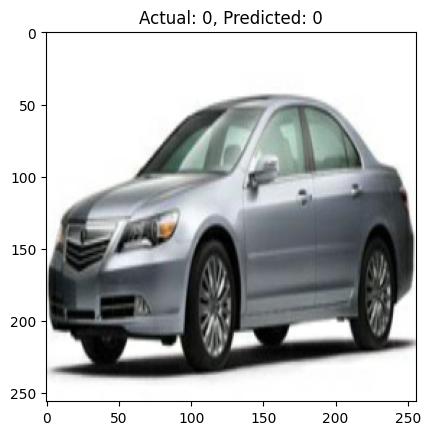

Actual: 0, Predicted: 0


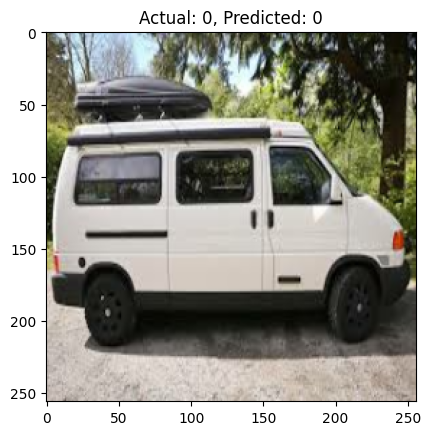

Actual: 0, Predicted: 0


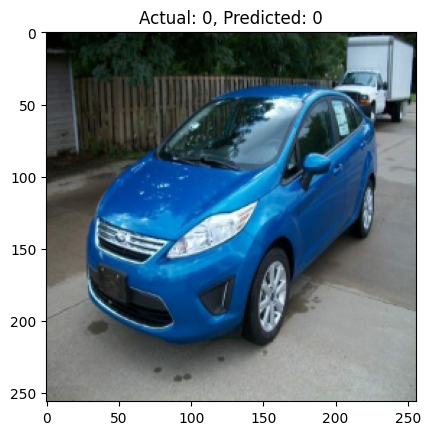

Actual: 0, Predicted: 0


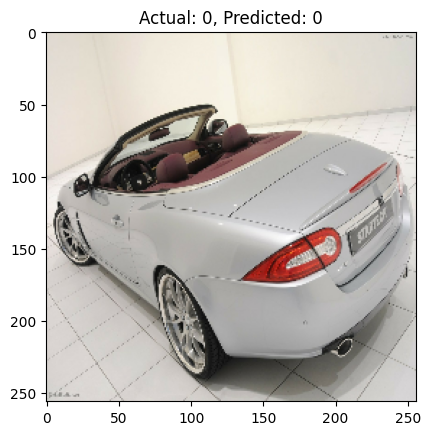

Actual: 0, Predicted: 0


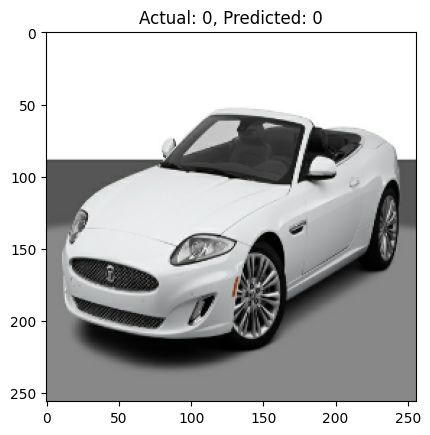

Actual: 1, Predicted: 1


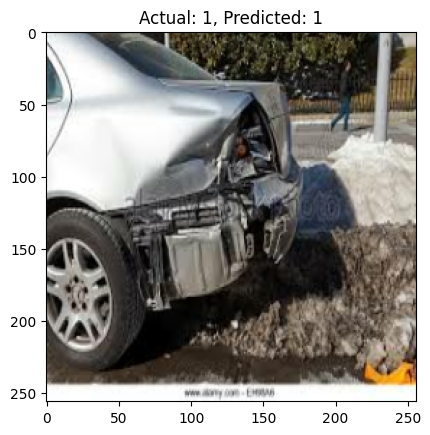

Actual: 0, Predicted: 1


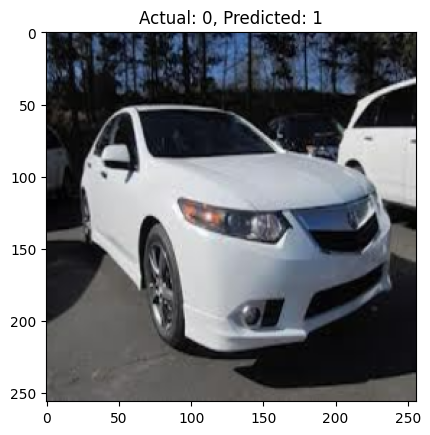

Actual: 0, Predicted: 1


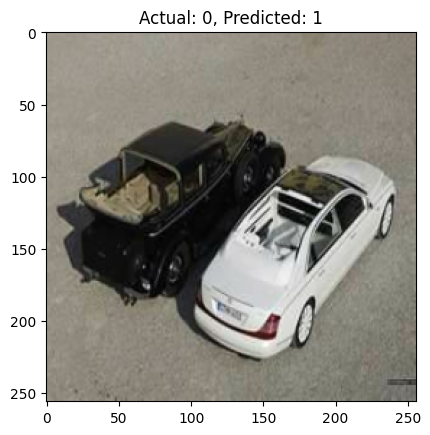

(32,) (32,)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
Actual: 0, Predicted: 1


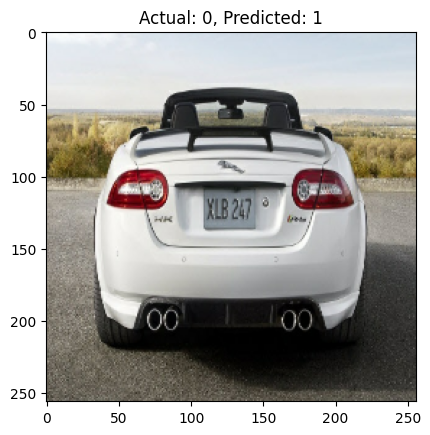

Actual: 1, Predicted: 1


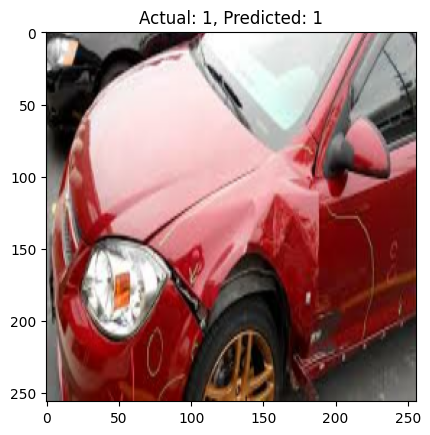

Actual: 1, Predicted: 1


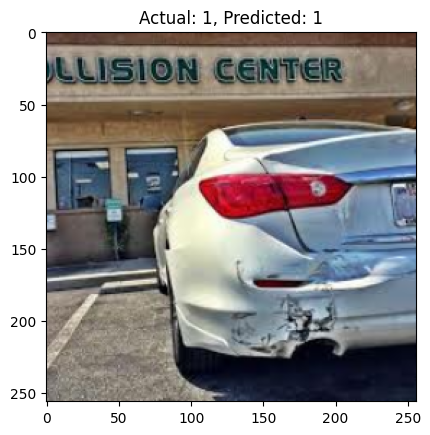

Actual: 0, Predicted: 1


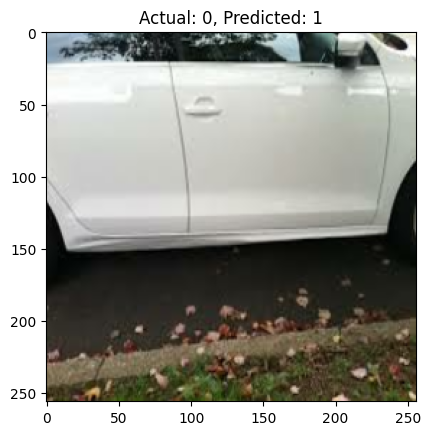

Actual: 0, Predicted: 0


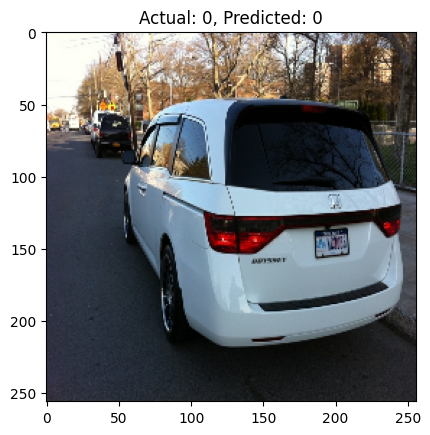

Actual: 1, Predicted: 1


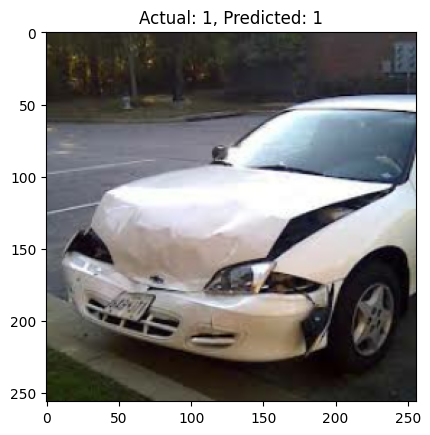

Actual: 1, Predicted: 1


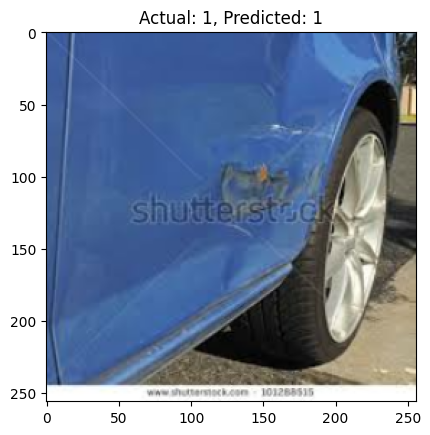

Actual: 0, Predicted: 0


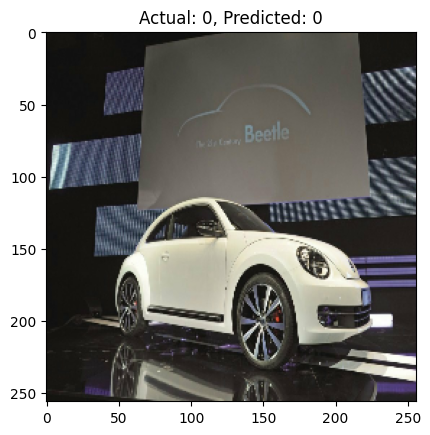

Actual: 1, Predicted: 1


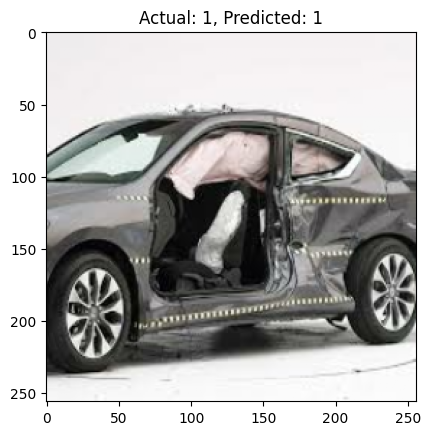

Actual: 1, Predicted: 1


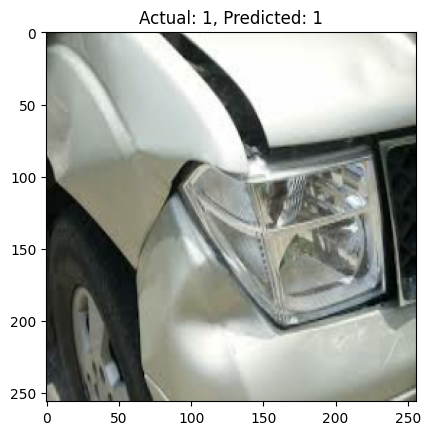

(10,) (10,)


In [33]:


pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    for i in range(len(y)):
        actual = y[i]
        predicted = yhat_classes[i]

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        #Display the image
        plt.imshow(X[i])
        plt.title(f"Actual: {actual}, Predicted: {predicted}")
        plt.show()
    print(y.shape,yhat_classes.shape)
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)




In [34]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    # One-hot encode the labels
    y_one_hot = tf.keras.utils.to_categorical(y, num_classes=num_classes)

    for i in range(len(y)):
        actual = y_one_hot[i]
        predicted = tf.one_hot(yhat_classes[i], depth=num_classes)

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        # Display the image
        # plt.imshow(X[i])
        # plt.title(f"Actual: {actual}, Predicted: {predicted}")
        # plt.show()

    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y_one_hot, yhat)
    re.update_state(y_one_hot, yhat)
    acc.update_state(y_one_hot, yhat)

pre_result = pre.result().numpy()
re_result = re.result().numpy()
acc_result = acc.result().numpy()

print(f'Precision: {pre_result}, Recall: {re_result}, Accuracy: {acc_result}')


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicte

In [35]:
print(f"Precision:{pre.result().numpy()}, Recall:{re.result().numpy()}, Accuracy:{acc.result().numpy()}")

Precision:0.8260869383811951, Recall:0.8260869383811951, Accuracy:0.8260869383811951


Test

In [36]:
import cv2

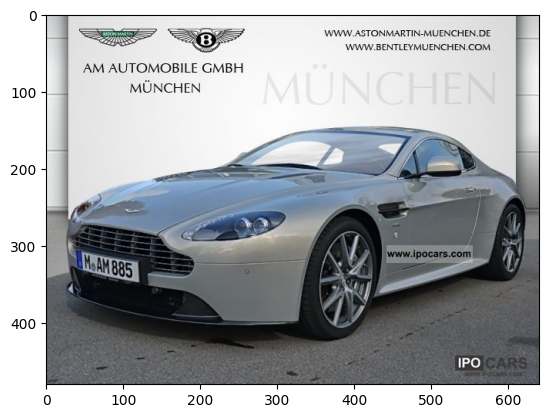

In [37]:
img=cv2.imread('test_image_0.jpg')
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show()

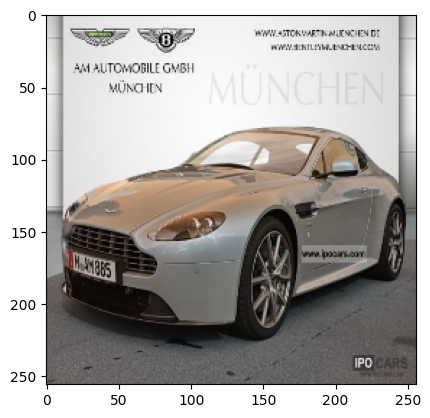

In [38]:
resize=tf.image.resize(img,(256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [39]:
yhat=model.predict(np.expand_dims(resize/255,0))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


In [40]:
predicted_class = np.argmax(yhat)
print(f'Predicted Class: {predicted_class}')

Predicted Class: 0


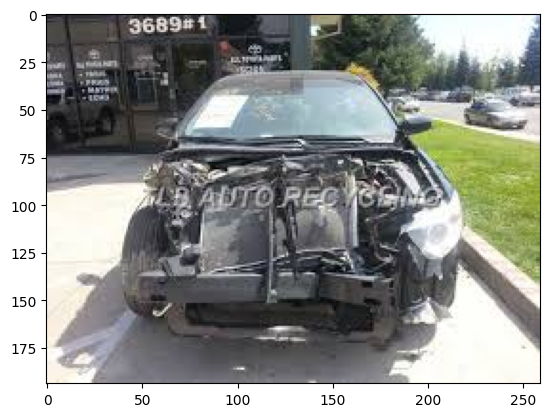

In [41]:
img=cv2.imread('test_image_1.jpeg')
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show()

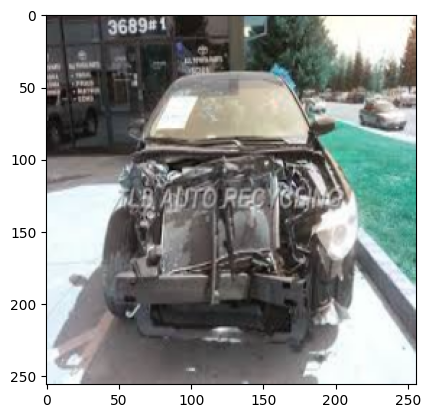

In [42]:
resize=tf.image.resize(img,(256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [43]:
yhat=model.predict(np.expand_dims(resize/255,0))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


In [44]:
predicted_class = np.argmax(yhat)
print(f'Predicted Class: {predicted_class}')

Predicted Class: 1


In [ ]:
###########################################

In [ ]:
###########################################

In [45]:
%pip install uvicorn gunicorn fastapi pydantic

Note: you may need to restart the kernel to use updated packages.


In [46]:
%pip list

Package                 VersionNote: you may need to restart the kernel to use updated packages.

----------------------- ------------
absl-py                 2.1.0
annotated-types         0.6.0
anyio                   4.3.0
asgiref                 3.7.2
asttokens               2.4.1
astunparse              1.6.3
certifi                 2024.2.2
charset-normalizer      3.3.2
click                   8.1.7
colorama                0.4.6
comm                    0.2.2
contourpy               1.2.1
cycler                  0.12.1
debugpy                 1.8.1
decorator               5.1.1
Django                  5.0.2
djangorestframework     3.14.0
executing               2.0.1
fastapi                 0.110.2
filelock                3.9.0
flatbuffers             24.3.25
fonttools               4.51.0
fsspec                  2023.4.0
gast                    0.5.4
google-pasta            0.2.0
grpcio                  1.62.2
gunicorn                22.0.0
h11                     0.14.0
h5py     

In [47]:
# Define the path where you want to save the model
model_path = "../DEPLOY_MODEL1/model1.h5"

# Save the model to the specified path
model.save(model_path)
